In [1]:
import numdifftools as nd
import sys 
import math
import xarray as xr
import cartopy.crs as ccrs
import matplotlib as mpl
from matplotlib import pyplot as plt 
import matplotlib.pylab as plt
from sklearn.decomposition import PCA
import matplotlib.path as mpath
from matplotlib.pyplot import figure
import numpy as np
import scipy as sp
import cartopy.feature as cfeature
import metpy.calc as mpcalc
from metpy.units import units
import pandas as pd 
import statistics
import traceback

#Plots: ocean currents, Wind speed, wind stress curl, wind stress
#Good stress curl to current pattern: 4,7,8

C:\Users\Anna\anaconda3\lib\site-packages\xarray\backends\cfgrib_.py:27: UserWarning: Failed to load cfgrib - most likely there is a problem accessing the ecCodes library. Try `import cfgrib` to get the full error message
  warnings.warn(


ModuleNotFoundError: No module named 'pint.unit'

In [216]:
#Variables
#March 26, 2018

#latitude, longitude
#mean_observation_time

#wind_speed in m/s, wind_dir in -180 to 180, 10m equiv neutral
#u_current, v_current in m/s 
#u_current_std, v_current_std in m/s 

#tau_x, tau_y, description m/s, units Pa - N/m^2 - downward stress at sea sfc 

#'du_current_dx', 'du_current_dy', 'dv_current_dx', 'dv_current_dy' in 1/s - 
#East component of surface current derivative (dus), North component of surface current derivative (dvs)
#'du_current_dx_std', 'du_current_dy_std', 'dv_current_dx_std', 'dv_current_dy_std' in 1/s 

#'surface_current_relative_vorticity' in 1/s 
#'surface_current_relative_vorticity_std' in 1/s 
#'surface_current_divergence' in 1/s 
#'surface_current_divergence_std' in 1/s 

#'surface_current_strain_rate' in 1/s 
#'coriolis_parameter' in 1/s 

# 'wind_stress_curl' in  N m-3
#'dtau_x_dx', 'dtau_x_dy', 'dtau_y_dx', 'dtau_y_dy' in  N m-3 - 
#East component of wind stress derivative in the e for dTaux, North component of wind stress derivative in the in dTauY


ds1 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0001-0110_line01.L2.nc')
ds2 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0118-0170_line02.L2.nc')
ds3 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0180-0227_line03.L2.nc')
ds4 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0238-0296_line04.L2.nc')
ds5 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0306-0348_line05.L2.nc')
#ds6 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0360-0375_line06.L2.nc')
ds7 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0377-0419_line07.L2.nc')
ds8 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0429-0470_line08.L2.nc')
ds9 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0485-0533_line09.L2.nc')
ds10 = xr.open_dataset('/Users/Anna/Desktop/MSMET/Thesis/JPL_March22/20180326_084656_0543-0581_line10.L2.nc')

#print(ds1.keys)
#print(ds1.variables)

Lat1=ds1.latitude.values
Lon1=ds1.longitude.values
Lat2=ds2.latitude.values
Lon2=ds2.longitude.values
Lat3=ds3.latitude.values
Lon3=ds3.longitude.values
Lat4=ds4.latitude.values
Lon4=ds4.longitude.values
Lat5=ds5.latitude.values
Lon5=ds5.longitude.values
#Lat6=ds6.latitude.values
#Lon6=ds6.longitude.values
Lat7=ds7.latitude.values
Lon7=ds7.longitude.values
Lat8=ds8.latitude.values
Lon8=ds8.longitude.values
#Lat9=ds9.latitude.values
#Lon9=ds9.longitude.values
Lat10=ds10.latitude.values
Lon10=ds10.longitude.values

#swaX=ds1.x.values
#swaY=ds1.y.values

#print(swaX.shape) #=Lon
#print(swaY.shape) #=Lat data given as (y,x)
#print(Lon1[:,])
#print(Lon1)
#print(Lat1.shape)
#print(swaX)
#print(swaY)
#uCur1=ds1.u_current.values
#print(uCur1.shape)

#Plot the data from x=0 to x = 278 an

In [215]:
uCur1=ds1.u_current.values
vCur1=ds1.v_current.values
uCur2=ds2.u_current.values
vCur2=ds2.v_current.values
uCur3=ds3.u_current.values
vCur3=ds3.v_current.values
uCur4=ds4.u_current.values
vCur4=ds4.v_current.values
uCur5=ds5.u_current.values
vCur5=ds5.v_current.values
#uCur6=ds6.u_current.values
#vCur6=ds6.v_current.values
uCur7=ds7.u_current.values
vCur7=ds7.v_current.values
uCur8=ds8.u_current.values
vCur8=ds8.v_current.values
#uCur9=ds9.u_current.values
#vCur9=ds9.v_current.values
uCur10=ds10.u_current.values
vCur10=ds10.v_current.values
curMag1=np.sqrt(uCur1**2+vCur1**2)
curMag2=np.sqrt(uCur2**2+vCur2**2)
curMag3=np.sqrt(uCur3**2+vCur3**2)
curMag4=np.sqrt(uCur4**2+vCur4**2)
curMag5=np.sqrt(uCur5**2+vCur5**2)
#curMag6=np.sqrt(uCur6**2+vCur6**2)
curMag7=np.sqrt(uCur7**2+vCur7**2)
curMag8=np.sqrt(uCur8**2+vCur8**2)
#curMag9=np.sqrt(uCur9**2+vCur9**2)
curMag10=np.sqrt(uCur10**2+vCur10**2)


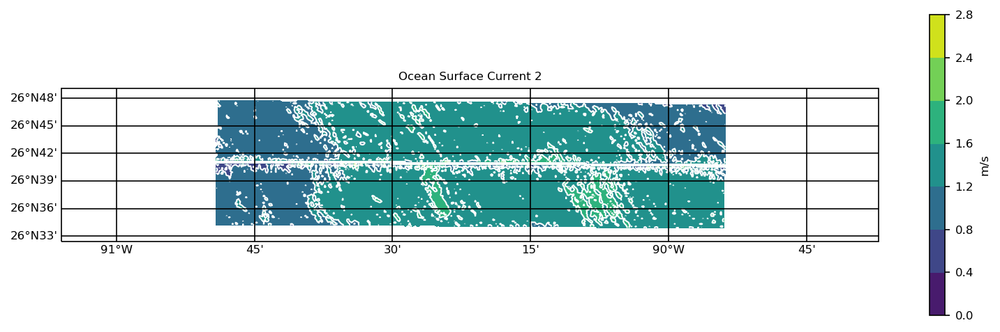

In [217]:
#Currents 2
#Contour
numX=len(Lon2)
numY=len(Lat2)

newCurMag2=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat2-2)):
    for x in range(0,len(Lon2-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if curMag2[y,x] <2.8 and curMag2[y,x]>=0.0:
                
                newCurMag2[y,x]=curMag2[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon2, Lat2, newCurMag2)
#contnour lines
ax.contour(Lon2, Lat2, newCurMag2, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ocean Surface Current 2')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

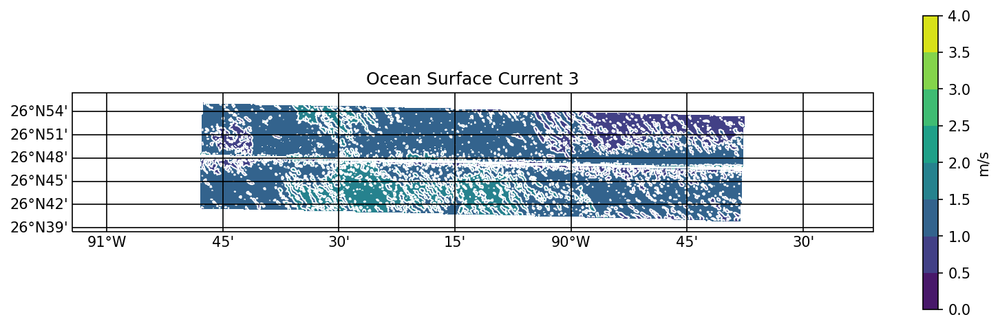

In [237]:
#Currents 3
#Contour
numX=len(Lon3)
numY=len(Lat3)

newCurMag3=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat3-2)):
    for x in range(0,len(Lon3-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if curMag3[y,x] <4.0 and curMag3[y,x]>=0.0:
                
                newCurMag3[y,x]=curMag3[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon3, Lat3, newCurMag3)
#contnour lines
ax.contour(Lon3, Lat3, newCurMag3, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ocean Surface Current 3')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

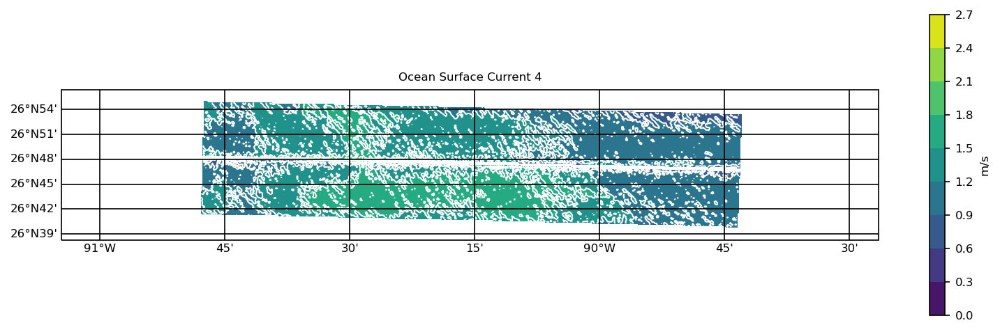

In [218]:
#Currents 4
#Contour
numX=len(Lon4)
numY=len(Lat4)

newCurMag4=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat4-2)):
    for x in range(0,len(Lon4-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if curMag4[y,x] <2.5 and curMag4[y,x]>=0.0:
                
                newCurMag4[y,x]=curMag4[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon4, Lat4, newCurMag4)
#contnour lines
ax.contour(Lon4, Lat4, newCurMag4, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ocean Surface Current 4')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

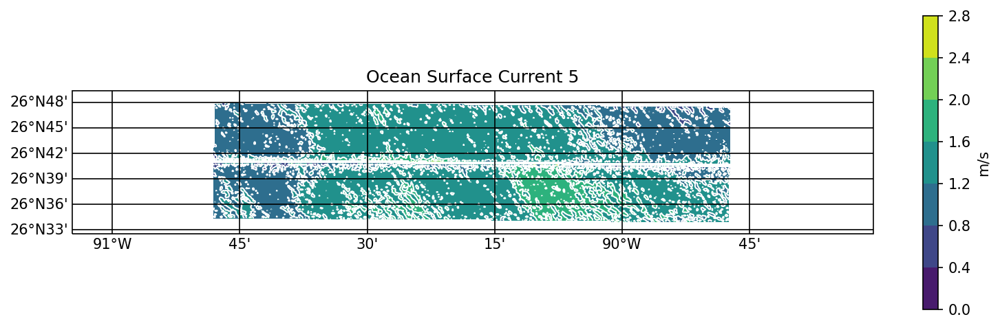

In [242]:
#Currents 5
#Contour
numX=len(Lon5)
numY=len(Lat5)

newCurMag5=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat5-2)):
    for x in range(0,len(Lon5-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if curMag5[y,x] <2.8 and curMag5[y,x]>=0.0:
                
                newCurMag5[y,x]=curMag5[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon5, Lat5, newCurMag5)
#contnour lines
ax.contour(Lon5, Lat5, newCurMag5, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ocean Surface Current 5')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

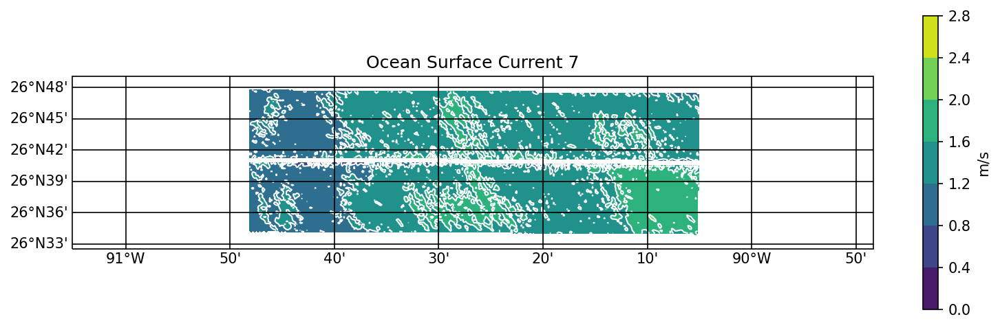

In [248]:
#Currents 7
#Contour
numX=len(Lon7)
numY=len(Lat7)

newCurMag7=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat7-2)):
    for x in range(0,len(Lon7-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if curMag7[y,x] <3.0 and curMag7[y,x]>=0.0:
                
                newCurMag7[y,x]=curMag7[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon7, Lat7, newCurMag7)
#contnour lines
ax.contour(Lon7, Lat7, newCurMag7, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ocean Surface Current 7')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

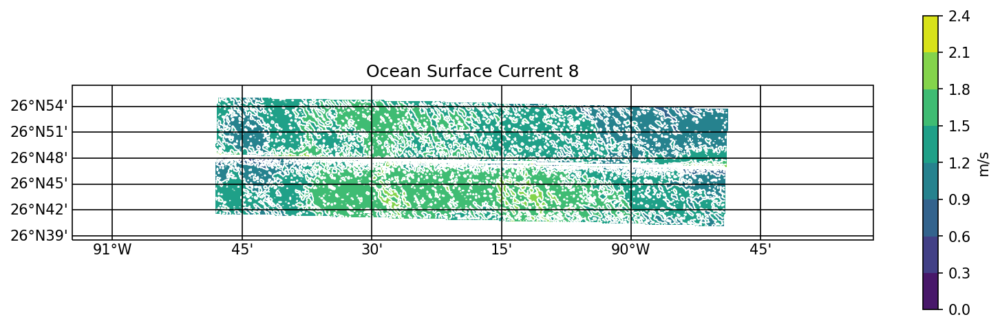

In [250]:
#Currents 8
#Contour
numX=len(Lon8)
numY=len(Lat8)

newCurMag8=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat8-2)):
    for x in range(0,len(Lon8-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if curMag8[y,x] <2.4 and curMag8[y,x]>=0.0:
                
                newCurMag8[y,x]=curMag8[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon8, Lat8, newCurMag8)
#contnour lines
ax.contour(Lon8, Lat8, newCurMag8, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Ocean Surface Current 8')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

In [227]:
# 'wind_stress_curl' in  N m-3
#'surface_current_divergence' in 1/s 
#'surface_current_relative_vorticity' in 1/s 
#wind_speed in m/s, wind_dir in -180 to 180, 10m equiv neutral

windSp1=ds1.wind_speed.values 
windDir1=ds1.wind_dir.values
windSp2=ds2.wind_speed.values 
windDir2=ds2.wind_dir.values
windSp3=ds3.wind_speed.values 
windDir3=ds3.wind_dir.values
windSp4=ds4.wind_speed.values 
windDir4=ds4.wind_dir.values
windSp5=ds5.wind_speed.values 
windDir5=ds5.wind_dir.values
#windSp6=ds6.wind_speed.values 
#windDir6=ds6.wind_dir.values
windSp7=ds7.wind_speed.values 
windDir7=ds7.wind_dir.values
windSp8=ds8.wind_speed.values 
windDir8=ds8.wind_dir.values
#windSp9=ds9.wind_speed.values 
#windDir9=ds9.wind_dir.values
windSp10=ds10.wind_speed.values 
windDir10=ds10.wind_dir.values

wDirMath1=90-windDir1*(np.pi/180)
wDirMath2=90-windDir2*(np.pi/180)
wDirMath3=90-windDir3*(np.pi/180)
wDirMath4=90-windDir4*(np.pi/180)
wDirMath5=90-windDir5*(np.pi/180)
#wDirMath6=90-windDir6*(np.pi/180)
wDirMath7=90-windDir7*(np.pi/180)
wDirMath8=90-windDir8*(np.pi/180)
#wDirMath9=90-windDir9*(np.pi/180)
wDirMath10=90-windDir10*(np.pi/180)

#windSpeed4=np.sqrt((windSp4*np.cos(wDirMath4))**2+(windSp4*np.sin(wDirMath4))**2)
#windSpeed7=np.sqrt((windSp7*np.cos(wDirMath7))**2+(windSp7*np.sin(wDirMath7))**2)
#windSpeed8=np.sqrt((windSp8*np.cos(wDirMath8))**2+(windSp8*np.sin(wDirMath8))**2)

#Calculate the U, V wind vector components from the speed and direction.
#metpy.calc.wind_components(speed, wind_direction)
windComponents1=mpcalc.wind_components(windSp1*units('m/s'), wDirMath1)
windComponents2=mpcalc.wind_components(windSp2*units('m/s'), wDirMath2)
windComponents3=mpcalc.wind_components(windSp3*units('m/s'), wDirMath3)
windComponents4=mpcalc.wind_components(windSp4*units('m/s'), wDirMath4)
windComponents5=mpcalc.wind_components(windSp5*units('m/s'), wDirMath5)
#windComponents6=mpcalc.wind_components(windSp6*units('m/s'), wDirMath6)
windComponents7=mpcalc.wind_components(windSp7*units('m/s'), wDirMath7)
windComponents8=mpcalc.wind_components(windSp8*units('m/s'), wDirMath8)
#windComponents9=mpcalc.wind_components(windSp9*units('m/s'), wDirMath9)
windComponents10=mpcalc.wind_components(windSp10*units('m/s'), wDirMath10)
#Compute the wind speed from u and v-components.
#metpy.calc.wind_speed(u, v)

windSpeed1=np.sqrt((windSp1*np.cos(wDirMath1*(180/np.pi)))**2+(windSp1*np.sin(wDirMath1*(180/np.pi)))**2)
windSpeed2=np.sqrt((windSp2*np.cos(wDirMath2*(180/np.pi)))**2+(windSp2*np.sin(wDirMath2*(180/np.pi)))**2)
windSpeed3=np.sqrt((windSp3*np.cos(wDirMath3*(180/np.pi)))**2+(windSp3*np.sin(wDirMath3*(180/np.pi)))**2)
windSpeed4=np.sqrt((windSp4*np.cos(wDirMath4*(180/np.pi)))**2+(windSp4*np.sin(wDirMath4*(180/np.pi)))**2)
windSpeed5=np.sqrt((windSp5*np.cos(wDirMath5*(180/np.pi)))**2+(windSp5*np.sin(wDirMath5*(180/np.pi)))**2)
#windSpeed6=np.sqrt((windSp6*np.cos(wDirMath6*(180/np.pi)))**2+(windSp6*np.sin(wDirMath6*(180/np.pi)))**2)
windSpeed7=np.sqrt((windSp7*np.cos(wDirMath7*(180/np.pi)))**2+(windSp7*np.sin(wDirMath7*(180/np.pi)))**2)
windSpeed8=np.sqrt((windSp8*np.cos(wDirMath8*(180/np.pi)))**2+(windSp8*np.sin(wDirMath8*(180/np.pi)))**2)
#windSpeed9=np.sqrt((windSp9*np.cos(wDirMath9*(180/np.pi)))**2+(windSp9*np.sin(wDirMath9*(180/np.pi)))**2)
windSpeed10=np.sqrt((windSp10*np.cos(wDirMath10*(180/np.pi)))**2+(windSp10*np.sin(wDirMath10*(180/np.pi)))**2)

#print(windSpeed4)
#print(windSpeed1)

#components 
windU1=windSp1*np.cos(wDirMath1*(180/np.pi))
windV1=windSp1*np.sin(wDirMath1*(180/np.pi))
windU2=windSp2*np.cos(wDirMath2*(180/np.pi))
windV2=windSp2*np.sin(wDirMath2*(180/np.pi))
windU3=windSp3*np.cos(wDirMath3*(180/np.pi))
windV3=windSp3*np.sin(wDirMath3*(180/np.pi))
windU4=windSp4*np.cos(wDirMath4*(180/np.pi))
windV4=windSp4*np.sin(wDirMath4*(180/np.pi))
windU5=windSp5*np.cos(wDirMath5*(180/np.pi))
windV5=windSp5*np.sin(wDirMath5*(180/np.pi))
windU7=windSp7*np.cos(wDirMath7*(180/np.pi))
windV7=windSp7*np.sin(wDirMath7*(180/np.pi))
windU8=windSp8*np.cos(wDirMath8*(180/np.pi))
windV8=windSp8*np.sin(wDirMath8*(180/np.pi))
windU9=windSp9*np.cos(wDirMath9*(180/np.pi))
windV9=windSp9*np.sin(wDirMath9*(180/np.pi))
windU10=windSp10*np.cos(wDirMath10*(180/np.pi))
windV10=windSp10*np.sin(wDirMath10*(180/np.pi))

#unit vector
U1_vec=windU1/windSpeed1
V1_vec=windV1/windSpeed1
U2_vec=windU2/windSpeed2
V2_vec=windV2/windSpeed2
U3_vec=windU3/windSpeed3
V3_vec=windV3/windSpeed3
U4_vec=windU4/windSpeed4
V4_vec=windV4/windSpeed4
U5_vec=windU5/windSpeed5
V5_vec=windV5/windSpeed5
U7_vec=windU7/windSpeed7
V7_vec=windV7/windSpeed7
U8_vec=windU8/windSpeed8
V8_vec=windV8/windSpeed8
U9_vec=windU9/windSpeed9
V9_vec=windV9/windSpeed9
U10_vec=windU10/windSpeed10
V10_vec=windV10/windSpeed10

#get perp to wind vector
U1_perp=-V1_vec
V1_perp=U1_vec
U2_perp=-V2_vec
V2_perp=U2_vec
U3_perp=-V3_vec
V3_perp=U3_vec
U4_perp=-V4_vec
V4_perp=U4_vec
U5_perp=-V5_vec
V5_perp=U5_vec
U7_perp=-V7_vec
V7_perp=U7_vec
U8_perp=-V8_vec
V8_perp=U8_vec
U9_perp=-V9_vec
V9_perp=U9_vec
U10_perp=-V10_vec
V10_perp=U10_vec

#currentMag perp to wind
perpCurrent1=U1_perp*uCur1 + V1_perp*vCur1
perpCurrent2=U2_perp*uCur2 + V2_perp*vCur2
perpCurrent3=U3_perp*uCur3 + V3_perp*vCur3
perpCurrent4=U4_perp*uCur4 + V4_perp*vCur4
perpCurrent5=U5_perp*uCur5 + V5_perp*vCur5
perpCurrent7=U7_perp*uCur7 + V7_perp*vCur7
perpCurrent8=U8_perp*uCur8 + V8_perp*vCur8
perpCurrent9=U9_perp*uCur9 + V9_perp*vCur9
perpCurrent10=U10_perp*uCur10 + V10_perp*vCur10

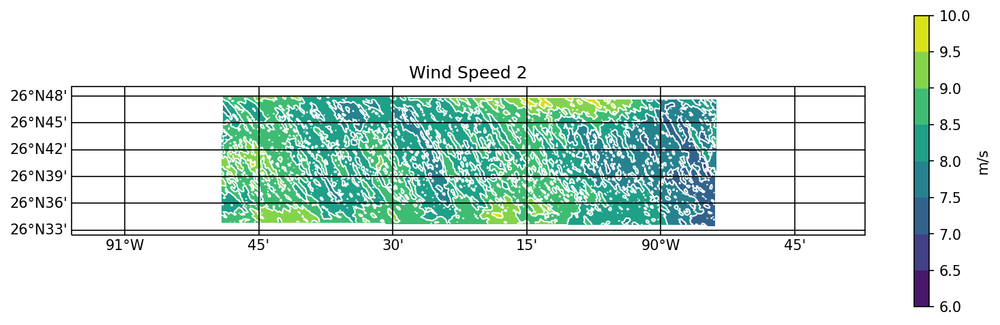

In [273]:
#Wind Speed 2
#Contour
numX=len(Lon2)
numY=len(Lat2)

newWindSpeed2=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat2-2)):
    for x in range(0,len(Lon2-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if windSpeed2[y,x] <10.0 and windSpeed2[y,x]>=6.0:
                
                newWindSpeed2[y,x]=windSpeed2[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon2, Lat2, newWindSpeed2)
#contnour lines
ax.contour(Lon2, Lat2, newWindSpeed2, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Speed 2')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

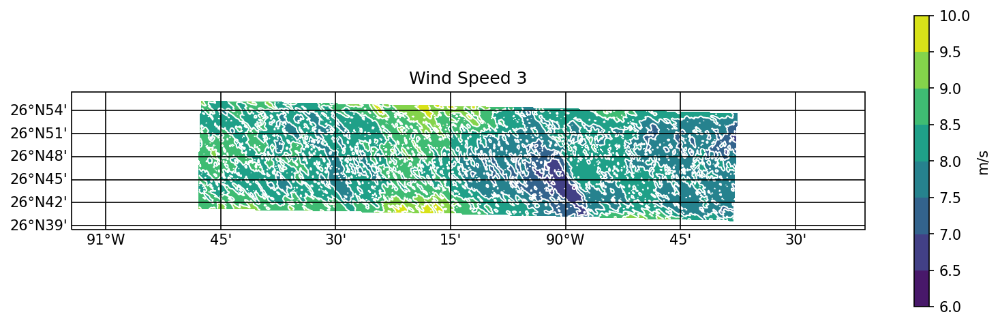

In [275]:
#Wind Speed 3
#Contour
numX=len(Lon3)
numY=len(Lat3)

newWindSpeed3=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat3-2)):
    for x in range(0,len(Lon3-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if windSpeed3[y,x] <10.0 and windSpeed3[y,x]>=6.0:
                
                newWindSpeed3[y,x]=windSpeed3[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon3, Lat3, newWindSpeed3)
#contnour lines
ax.contour(Lon3, Lat3, newWindSpeed3, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Speed 3')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

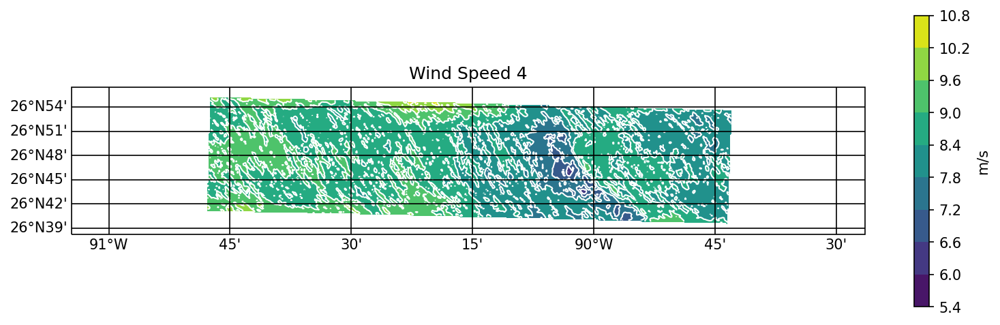

In [277]:
#Wind Speed 4
#Contour
numX=len(Lon4)
numY=len(Lat4)

newWindSpeed4=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat4-2)):
    for x in range(0,len(Lon4-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if windSpeed4[y,x] <10.4 and windSpeed4[y,x]>=5.6:
                
                newWindSpeed4[y,x]=windSpeed4[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon4, Lat4, newWindSpeed4)
#contnour lines
ax.contour(Lon4, Lat4, newWindSpeed4, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Speed 4')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

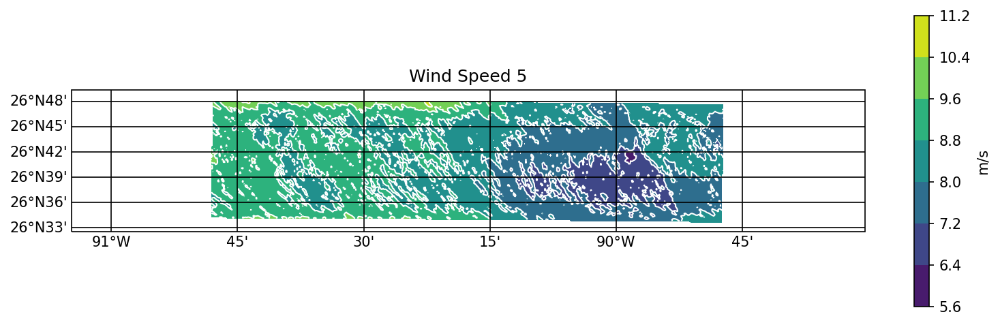

In [279]:
#Wind Speed 5
#Contour
numX=len(Lon5)
numY=len(Lat5)

newWindSpeed5=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat5-2)):
    for x in range(0,len(Lon5-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if windSpeed5[y,x] <11.2 and windSpeed5[y,x]>=5.6:
                
                newWindSpeed5[y,x]=windSpeed5[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon5, Lat5, newWindSpeed5)
#contnour lines
ax.contour(Lon5, Lat5, newWindSpeed5, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Speed 5')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

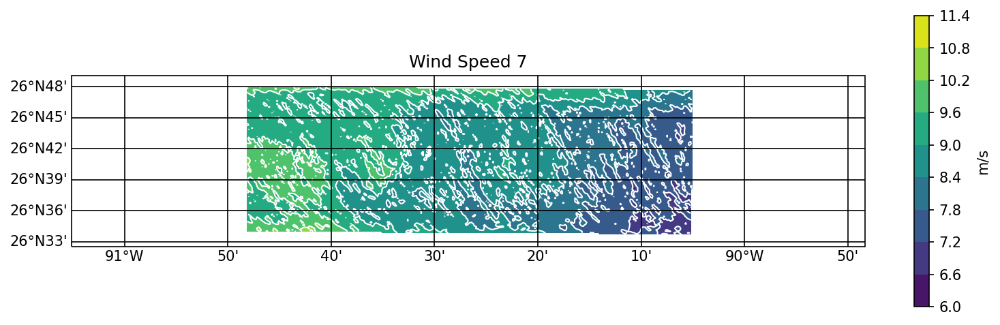

In [285]:
#Wind Speed 7
#Contour
numX=len(Lon7)
numY=len(Lat7)

newWindSpeed7=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat7-2)):
    for x in range(0,len(Lon7-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if windSpeed7[y,x] <11.4 and windSpeed7[y,x]>=6.0:
                
                newWindSpeed7[y,x]=windSpeed7[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon7, Lat7, newWindSpeed7)
#contnour lines
ax.contour(Lon7, Lat7, newWindSpeed7, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Speed 7')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

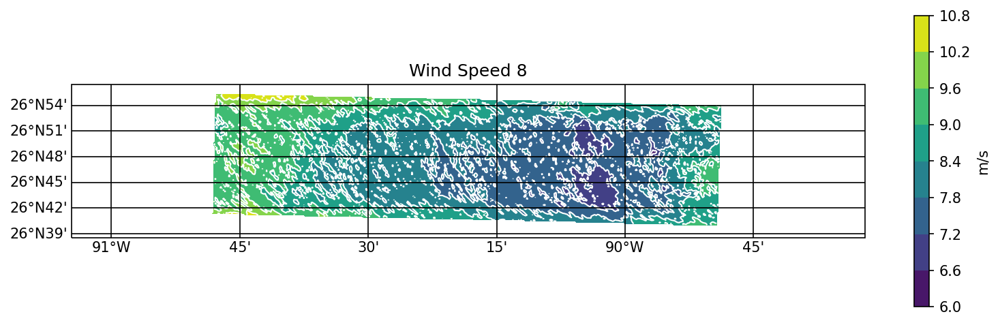

In [20]:
#Wind Speed 8
#Contour
numX=len(Lon8)
numY=len(Lat8)

newWindSpeed8=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat8-2)):
    for x in range(0,len(Lon8-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if windSpeed8[y,x] <10.8 and windSpeed8[y,x]>=6.0:
                
                newWindSpeed8[y,x]=windSpeed8[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon8, Lat8, newWindSpeed8)
#contnour lines
ax.contour(Lon8, Lat8, newWindSpeed8, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'm/s')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Speed 8')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

In [26]:
# 'wind_stress_curl' in  N m-3
#'surface_current_divergence' in 1/s 
#'surface_current_relative_vorticity' in 1/s

stressCurl1=ds1.wind_stress_curl.values
stressCurl2=ds2.wind_stress_curl.values
stressCurl3=ds3.wind_stress_curl.values
stressCurl4=ds4.wind_stress_curl.values
stressCurl5=ds5.wind_stress_curl.values
stressCurl6=ds6.wind_stress_curl.values
stressCurl7=ds7.wind_stress_curl.values
stressCurl8=ds8.wind_stress_curl.values
stressCurl9=ds9.wind_stress_curl.values
stressCurl10=ds10.wind_stress_curl.values


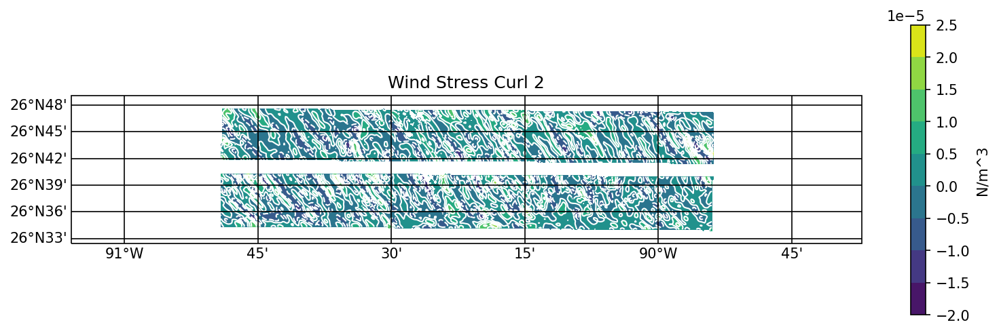

In [327]:
#Stress Curl 2
#Contour
numX=len(Lon2)
numY=len(Lat2)

newCurl2=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat2-2)):
    for x in range(0,len(Lon2-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressCurl2[y,x] <5.0 and stressCurl2[y,x]>=-5.0:
                
                newCurl2[y,x]=stressCurl2[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon2, Lat2, newCurl2)
#contnour lines
ax.contour(Lon2, Lat2, newCurl2, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^3')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress Curl 2')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

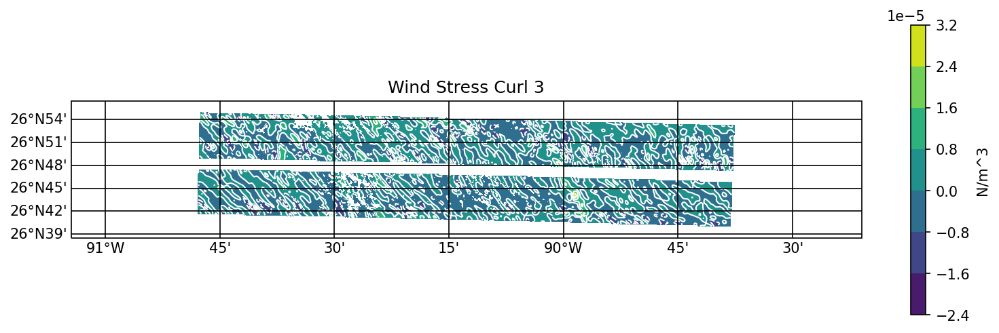

In [328]:
#Stress Curl 3
#Contour
numX=len(Lon3)
numY=len(Lat3)

newCurl3=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat3-2)):
    for x in range(0,len(Lon3-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressCurl3[y,x] <5.0 and stressCurl3[y,x]>=-5.0:
                
                newCurl3[y,x]=stressCurl3[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon3, Lat3, newCurl3)
#contnour lines
ax.contour(Lon3, Lat3, newCurl3, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^3')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress Curl 3')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

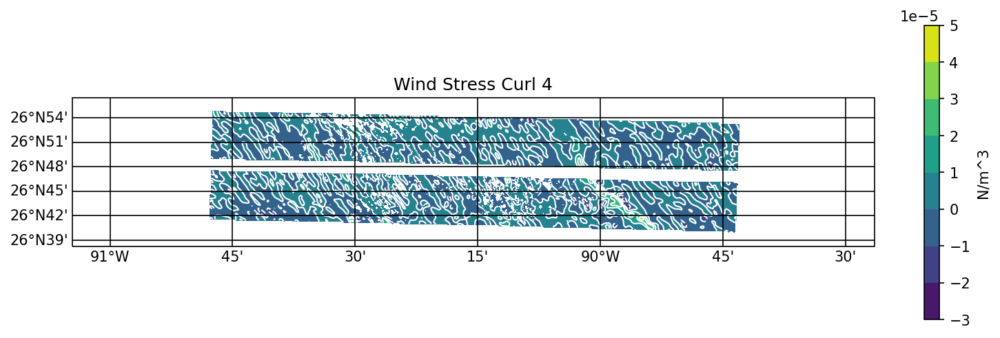

In [329]:
#Stress Curl 4
#Contour
numX=len(Lon4)
numY=len(Lat4)

newCurl4=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat4-2)):
    for x in range(0,len(Lon4-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressCurl4[y,x] <5.0 and stressCurl4[y,x]>=-5.0:
                
                newCurl4[y,x]=stressCurl4[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon4, Lat4, newCurl4)
#contnour lines
ax.contour(Lon4, Lat4, newCurl4, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^3')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress Curl 4')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

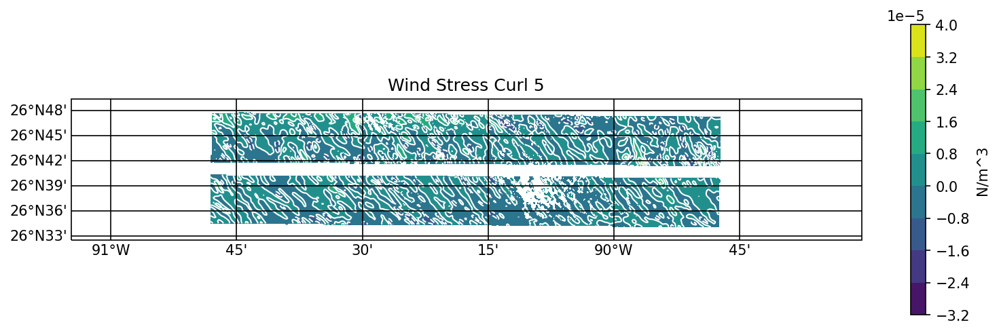

In [330]:
#Stress Curl 5
#Contour
numX=len(Lon5)
numY=len(Lat5)

newCurl5=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat5-2)):
    for x in range(0,len(Lon5-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressCurl5[y,x] <5.0 and stressCurl5[y,x]>=-5.0:
                
                newCurl5[y,x]=stressCurl5[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon5, Lat5, newCurl5)
#contnour lines
ax.contour(Lon5, Lat5, newCurl5, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^3')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress Curl 5')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

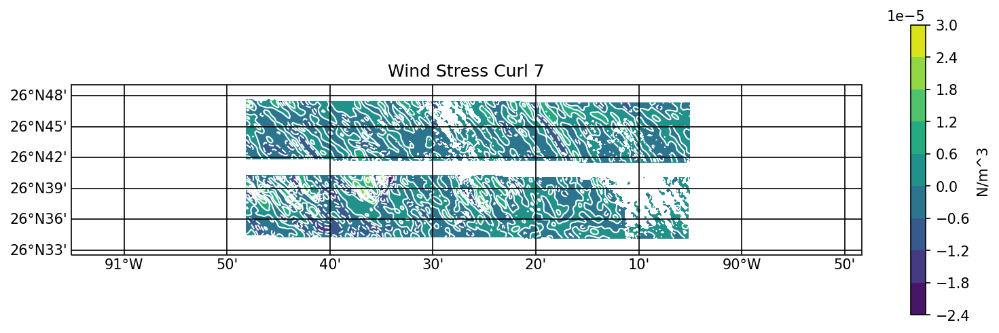

In [332]:
#Stress Curl 7
#Contour
numX=len(Lon7)
numY=len(Lat7)

newCurl7=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat7-2)):
    for x in range(0,len(Lon7-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressCurl7[y,x] <5.0 and stressCurl7[y,x]>=-5.0:
                
                newCurl7[y,x]=stressCurl7[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon7, Lat7, newCurl7)
#contnour lines
ax.contour(Lon7, Lat7, newCurl7, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^3')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress Curl 7')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

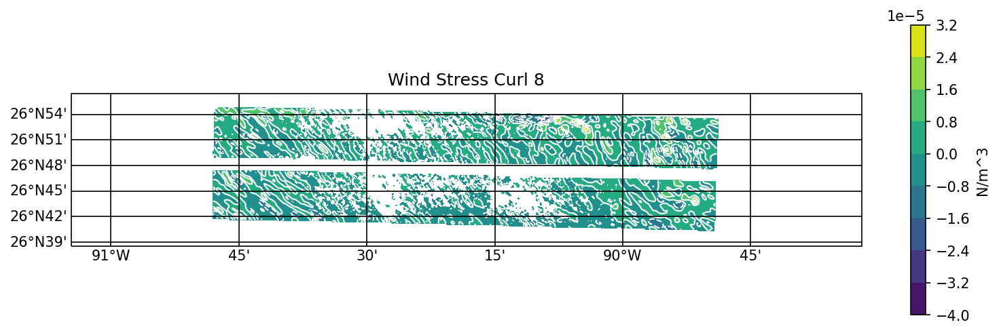

In [333]:
#Stress Curl 8
#Contour
numX=len(Lon8)
numY=len(Lat8)

newCurl8=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat8-2)):
    for x in range(0,len(Lon8-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressCurl8[y,x] <5.0 and stressCurl8[y,x]>=-5.0:
                
                newCurl8[y,x]=stressCurl8[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(10, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon8, Lat8, newCurl8)
#contnour lines
ax.contour(Lon8, Lat8, newCurl8, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^3')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress Curl 8')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

In [46]:
#'surface_current_relative_vorticity' in 1/s

#sfcCurVort1=ds1.surface_current_relative_vorticity.values
#sfcCurVort2=ds2.surface_current_relative_vorticity.values
#sfcCurVort3=ds3.surface_current_relative_vorticity.values
#sfcCurVort4=ds4.surface_current_relative_vorticity.values
#sfcCurVort5=ds5.surface_current_relative_vorticity.values
#sfcCurVort6=ds6.surface_current_relative_vorticity.values
#sfcCurVort7=ds7.surface_current_relative_vorticity.values
#sfcCurVort8=ds8.surface_current_relative_vorticity.values
#sfcCurVort9=ds9.surface_current_relative_vorticity.values
#sfcCurVort10=ds10.surface_current_relative_vorticity.values

#'surface_current_divergence' in 1/s 

#sfcCurDiv1=ds1.surface_current_divergence.values
#sfcCurDiv2=ds2.surface_current_divergence.values
#sfcCurDiv3=ds3.surface_current_divergence.values
#sfcCurDiv4=ds4.surface_current_divergence.values
#sfcCurDiv5=ds5.surface_current_divergence.values
#sfcCurDiv6=ds6.surface_current_divergence.values
#sfcCurDiv7=ds7.surface_current_divergence.values
#sfcCurDiv8=ds8.surface_current_divergence.values
#sfcCurDiv9=ds9.surface_current_divergence.values
#sfcCurDiv10=ds10.surface_current_divergence.values

In [24]:
#tau_x, tau_y, description m/s, units Pa - downward stress at sea sfc 
#tau_x, tau_y, description m/s, units Pa - N/m^2 - downward stress at sea sfc 

tauU1=ds1.tau_x.values
tauV1=ds1.tau_y.values
tauU2=ds2.tau_x.values
tauV2=ds2.tau_y.values
tauU3=ds3.tau_x.values
tauV3=ds3.tau_y.values
tauU4=ds4.tau_x.values
tauV4=ds4.tau_y.values
tauU5=ds5.tau_x.values
tauV5=ds5.tau_y.values
#tauU6=ds6.tau_x.values
#tauV6=ds6.tau_y.values
tauU7=ds7.tau_x.values
tauV7=ds7.tau_y.values
tauU8=ds8.tau_x.values
tauV8=ds8.tau_y.values
tauU9=ds9.tau_x.values
tauV9=ds9.tau_y.values
tauU10=ds10.tau_x.values
tauV10=ds10.tau_y.values

stressMag1=np.sqrt(tauU1**2+tauV1**2)
stressMag2=np.sqrt(tauU2**2+tauV2**2)
stressMag3=np.sqrt(tauU3**2+tauV3**2)
stressMag4=np.sqrt(tauU4**2+tauV4**2)
stressMag5=np.sqrt(tauU5**2+tauV5**2)
#stressMag6=np.sqrt(tauU6**2+tauV6**2)
stressMag7=np.sqrt(tauU7**2+tauV7**2)
stressMag8=np.sqrt(tauU8**2+tauV8**2)
stressMag9=np.sqrt(tauU9**2+tauV9**2)
stressMag10=np.sqrt(tauU10**2+tauV10**2)

#unit vector
#stressU1_vec=tauU1/stressMag1
#stressV1_vec=tauV1/stressMag1
#stressU2_vec=tauU2/stressMag2
#stressV2_vec=tauV2/stressMag2
#stressU3_vec=tauU3/stressMag3
#stressV3_vec=tauV3/stressMag3
#stressU4_vec=tauU4/stressMag4
#stressV4_vec=tauV4/stressMag4
#stressU5_vec=tauU5/stressMag5
#stressV5_vec=tauV5/stressMag5
#stressU7_vec=tauU7/stressMag7
#stressV7_vec=tauV7/stressMag7
#stressU8_vec=tauU8/stressMag8
#stressV8_vec=tauV8/stressMag8
#stressU9_vec=tauU9/stressMag9
#stressV9_vec=tauV9/stressMag9
#stressU10_vec=tauU10/stressMag10
#stressV10_vec=tauV10/stressMag10


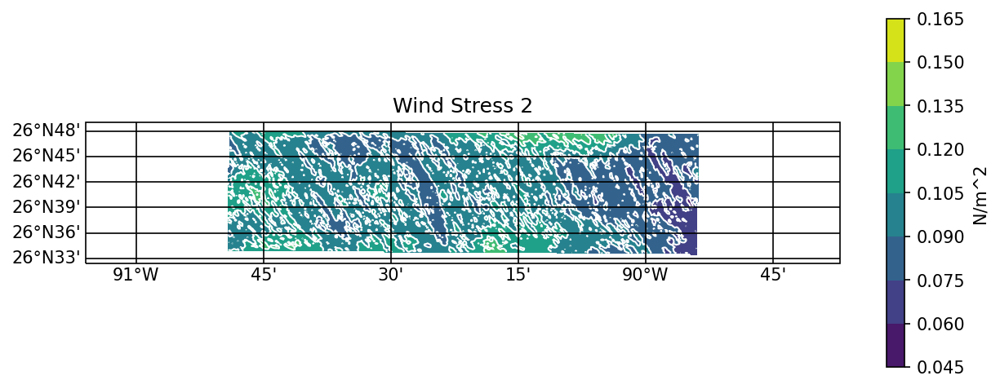

In [341]:
#Wind Stress 2
#Contour

numX=len(Lon2)
numY=len(Lat2)

newStressMag2=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat2-2)):
    for x in range(0,len(Lon2-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressMag2[y,x] <0.165 and stressMag2[y,x]>=0.045:
                
                newStressMag2[y,x]=stressMag2[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon2, Lat2, newStressMag2)
#contnour lines
ax.contour(Lon2, Lat2, newStressMag2, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^2')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress 2')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

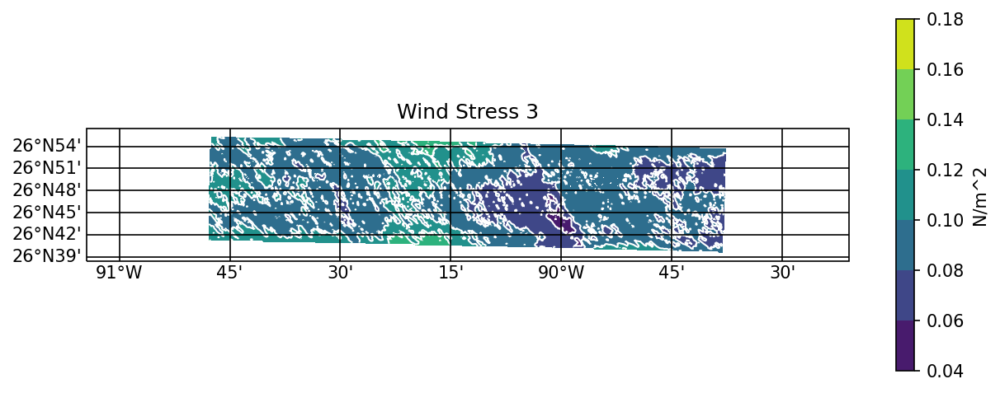

In [348]:
#Wind Stress 3
#Contour

numX=len(Lon3)
numY=len(Lat3)

newStressMag3=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat3-2)):
    for x in range(0,len(Lon3-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressMag3[y,x] <0.18 and stressMag3[y,x]>=0.04:
                
                newStressMag3[y,x]=stressMag3[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon3, Lat3, newStressMag3)
#contnour lines
ax.contour(Lon3, Lat3, newStressMag3, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^2')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress 3')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

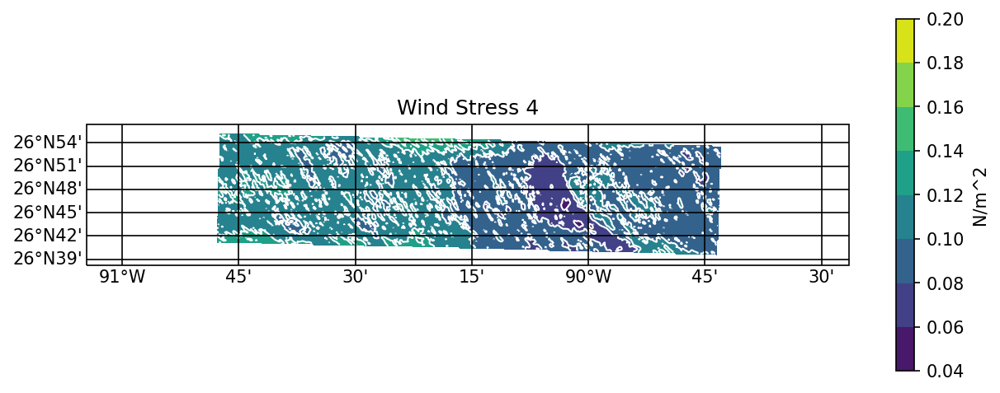

In [350]:
#Wind Stress 4
#Contour

numX=len(Lon4)
numY=len(Lat4)

newStressMag4=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat4-2)):
    for x in range(0,len(Lon4-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressMag4[y,x] <0.20 and stressMag4[y,x]>=0.04:
                
                newStressMag4[y,x]=stressMag4[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon4, Lat4, newStressMag4)
#contnour lines
ax.contour(Lon4, Lat4, newStressMag4, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^2')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress 4')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

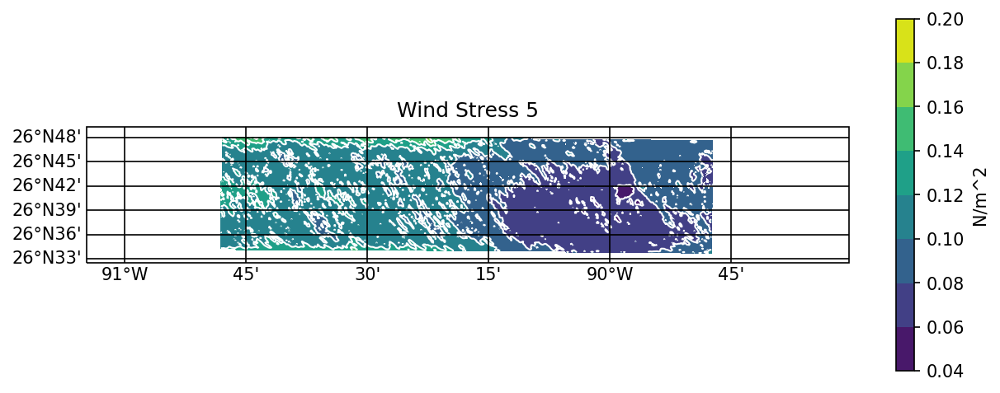

In [352]:
#Wind Stress 5
#Contour

numX=len(Lon5)
numY=len(Lat5)

newStressMag5=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat5-2)):
    for x in range(0,len(Lon5-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressMag5[y,x] <0.2 and stressMag5[y,x]>=0.025:
                
                newStressMag5[y,x]=stressMag5[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon5, Lat5, newStressMag5)
#contnour lines
ax.contour(Lon5, Lat5, newStressMag5, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^2')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress 5')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

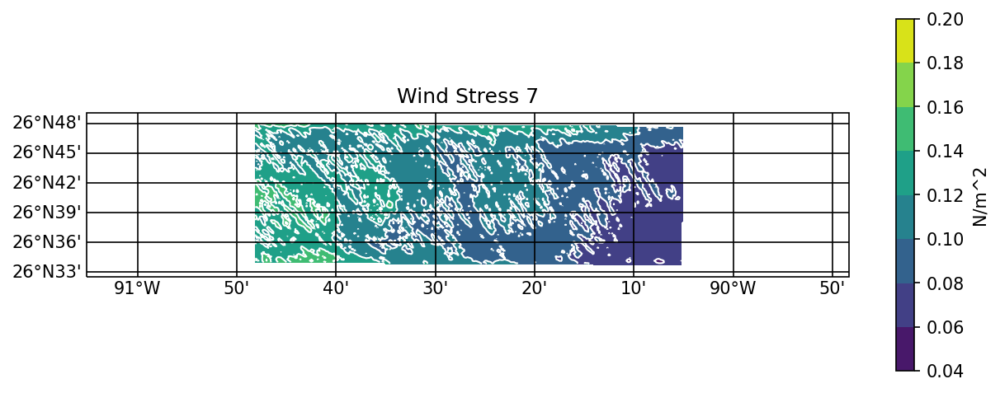

In [356]:
#Wind Stress 7
#Contour

numX=len(Lon7)
numY=len(Lat7)

newStressMag7=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat7-2)):
    for x in range(0,len(Lon7-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressMag7[y,x] <0.20 and stressMag7[y,x]>=0.04:
                
                newStressMag7[y,x]=stressMag7[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon7, Lat7, newStressMag7)
#contnour lines
ax.contour(Lon7, Lat7, newStressMag7, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^2')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress 7')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

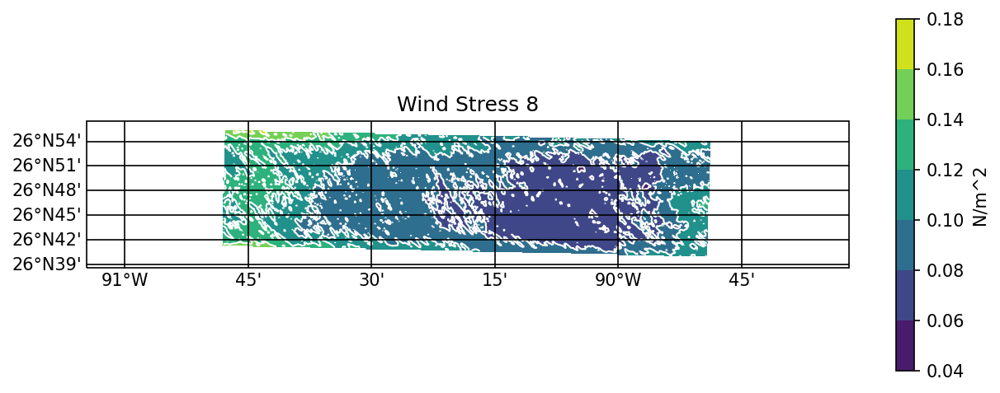

In [358]:
#Wind Stress 8
#Contour

numX=len(Lon8)
numY=len(Lat8)

newStressMag8=np.zeros((numY, numX))*np.nan

for y in range(0,len(Lat8-2)):
    for x in range(0,len(Lon8-2)):
        #if np.isnan(curlMag1[y,x]) == False:
        if stressMag8[y,x] <0.18 and stressMag8[y,x]>=0.04:
                
                newStressMag8[y,x]=stressMag8[y,x]
                

mapcrs = ccrs.PlateCarree()
fig = plt.figure(figsize=(8, 6), dpi=150)
ax = fig.add_subplot(111, projection=mapcrs)
#gives coastlines
ax.coastlines()
#filled contours (lon, lat, thing plotted)
cs = ax.contourf(Lon8, Lat8, newStressMag8)
#contnour lines
ax.contour(Lon8, Lat8, newStressMag8, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax.contour(Lon, Lat, SSTC, colors = 'white', linewidths = 1, transform=ccrs.PlateCarree())
#ax=plt.gca()
PCM=ax.get_children()[2]
plt.colorbar(cs, ax=ax, shrink = 0.5, label = 'N/m^2')
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False, color = 'black')
#don't want labels
plt.tight_layout()
gl.top_labels = False
gl.ylabels_right = False
plt.title('Wind Stress 8')
#plt.xlim([25, 50])
#plt.savefig('PV_110.png', bbox_inches='tight', dpi=150)
plt.show()

In [236]:
#do wind bins for ds1 (#1.5-11m/s)

numX=len(Lon1)
numY=len(Lat1)

#3rd dimension: diffy[0] diffx[1] - diff is xy
#this way to fill nans may cause div by 0 from nan*0

wind67stress=np.zeros((numY, numX, 2)) *np.nan
wind910stress=np.zeros((numY, numX, 2)) *np.nan

wind67stressCurl=np.zeros((numY, numX, 2))*np.nan
wind910stressCurl=np.zeros((numY, numX, 2))*np.nan

wind67currentMag=np.zeros((numY, numX, 2))*np.nan
wind910currentMag=np.zeros((numY, numX, 2))*np.nan

wind67perp=np.zeros((numY, numX, 2))*np.nan
wind910perp=np.zeros((numY, numX, 2))*np.nan

thresh=0.1 #0.1 m/s or higher 

#-1 in loop to note I have nans on edges when I plot 
for y in range(0,len(Lat1-1)):
    for x in range(0,len(Lon1-1)):
        if np.isnan(windSpeed1[y,x]) == False:
            
            #calculate differences in x and y 
            currentMag_x=curMag1[y,x+1]-curMag1[y,x] 
            currentMag_y=curMag1[y+1,x]-curMag1[y,x] 
            
            #currentMag perp to wind
            #perpCurrent=U1_perp*uCur1 + V1_perp*vCur1
            perp_x=perpCurrent1[y,x+1]-perpCurrent1[y,x]
            perp_y=perpCurrent1[y+1,x]-perpCurrent1[y,x]
            
            stressMag_x=stressMag1[y,x+1]-stressMag1[y,x]
            stressMag_y=stressMag1[y+1,x]-stressMag1[y,x]

            stressCurlDiffx=stressCurl1[y,x+1]-stressCurl1[y,x]
            stressCurlDiffy=stressCurl1[y+1,x]-stressCurl1[y,x]
            
            #check current magnitude threshold 
            if currentMag_x <thresh:
                currentMag_x = np.nan
            if currentMag_y <thresh: 
                currentMag_y = np.nan
                

            elif windSpeed1[y,x] <7.0 and windSpeed1[y,x]>=6.0:

                wind67stressCurl[y,x,1]=stressCurlDiffx
                wind67stressCurl[y,x,0]=stressCurlDiffy
                
                wind67perp[y,x,1]=perp_x
                wind67perp[y,x,0]=perp_y
                      
                wind67stress[y,x,1]=stressMag_x
                wind67stress[y,x,0]=stressMag_y
                            
                wind67currentMag[y,x,1]=currentMag_x
                wind67currentMag[y,x,0]=currentMag_y
                
                
            elif windSpeed1[y,x]<10.0 and windSpeed1[y,x]>=9.0:
                
                wind910currentMag[y,x,1]=currentMag_x
                wind910currentMag[y,x,0]=currentMag_y
                
                wind910perp[y,x,1]=perp_x
                wind910perp[y,x,0]=perp_y
                
                wind910stressCurl[y,x,1]=stressCurlDiffx
                wind910stressCurl[y,x,0]=stressCurlDiffy
                      
                wind910stress[y,x,1]=stressMag_x
                wind910stress[y,x,0]=stressMag_y

                
            else: 
                continue 



In [237]:
#ds1
wind67_curMag_x=wind67currentMag[:,:,1].flatten()
wind910_curMag_x=wind910currentMag[:,:,1].flatten()

wind67_curMag_y=wind67currentMag[:,:,0].flatten()
wind910_curMag_y=wind910currentMag[:,:,0].flatten()

wind67_Curl_x=wind67stressCurl[:,:,1].flatten()
wind910_Curl_x=wind910stressCurl[:,:,1].flatten()

wind67_Curl_y=wind67stressCurl[:,:,0].flatten()
wind910_Curl_y=wind910stressCurl[:,:,0].flatten()

wind67_Stress_x=wind67stress[:,:,1].flatten()
wind910_Stress_x=wind910stress[:,:,1].flatten()

wind67_Stress_y=wind67stress[:,:,0].flatten()
wind910_Stress_y=wind910stress[:,:,0].flatten()

wind67_PerpX=wind67perp[:,:,1].flatten()
wind910_PerpX=wind910perp[:,:,1].flatten()

wind67_PerpY=wind67perp[:,:,0].flatten()
wind910_PerpY=wind910perp[:,:,0].flatten()



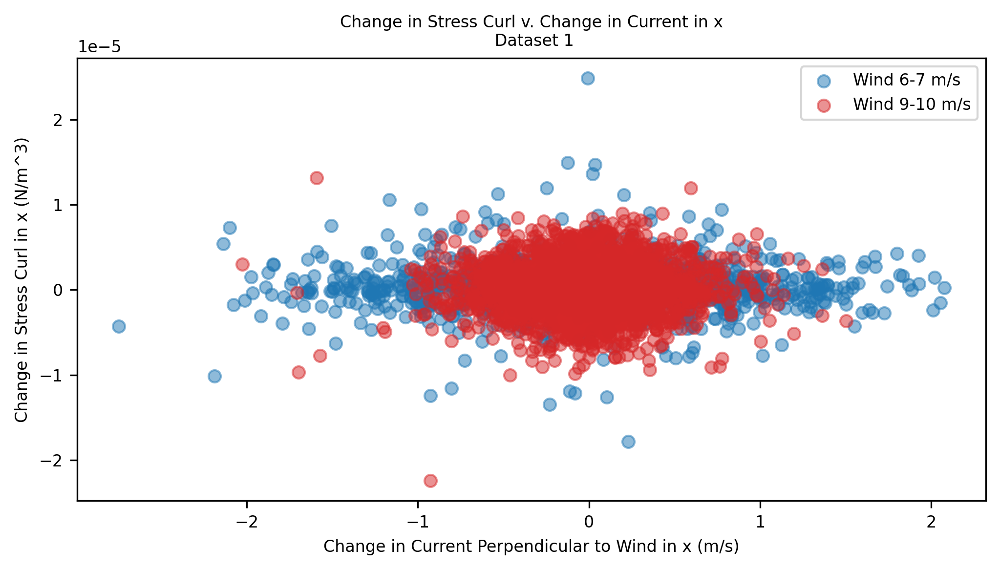

In [238]:
#stress curl x plot 1 

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid

plt.scatter(wind67_PerpX, wind67_Curl_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Curl_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")


plt.title('Change in Stress Curl v. Change in Current in x\n Dataset 1')
plt.ylabel('Change in Stress Curl in x (N/m^3)')
plt.xlabel('Change in Current Perpendicular to Wind in x (m/s)')

plt.show()


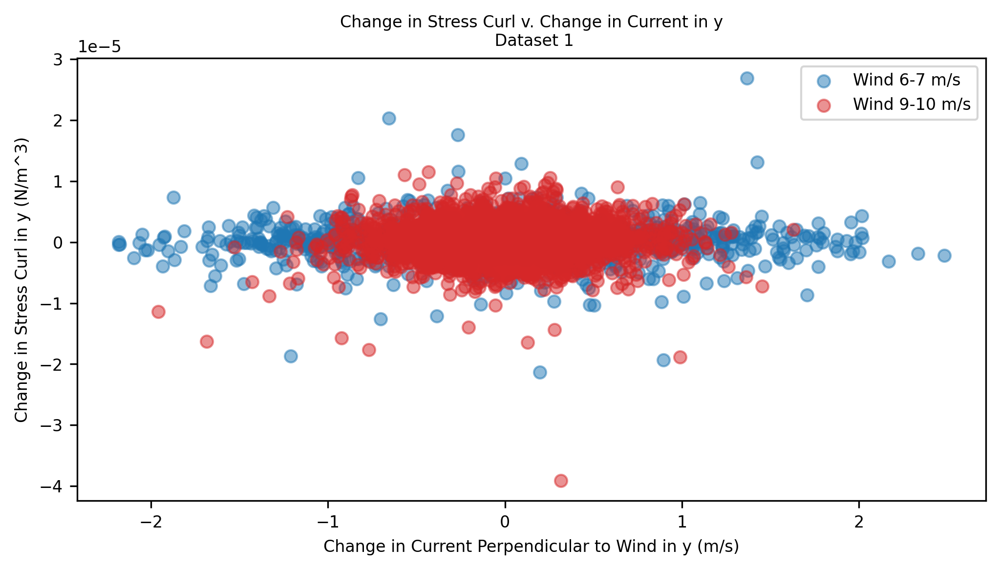

In [240]:
#stress curl y plot 1 

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid

plt.scatter(wind67_PerpY, wind67_Curl_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Curl_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")

#trendline with slope 
#mask = ~np.isnan(wind56_curMag_x) and ~np.isnan(wind56_Curl_x)
#z = np.polyfit(x, y, 1)
#z = np.polyfit(wind56_curMag_x[mask], wind56_Curl_x[mask] , 1)
#result1=PCA(wind56_curMag_x)
#result2=PCA(wind56_Curl_x)
#z = np.polyfit(result1, result2 , 1)
#p = np.poly1d(z)
#plt.plot(x,p(x),"tab:blue")

plt.title('Change in Stress Curl v. Change in Current in y\n Dataset 1')
plt.ylabel('Change in Stress Curl in y (N/m^3)')
plt.xlabel('Change in Current Perpendicular to Wind in y (m/s)')

plt.show()


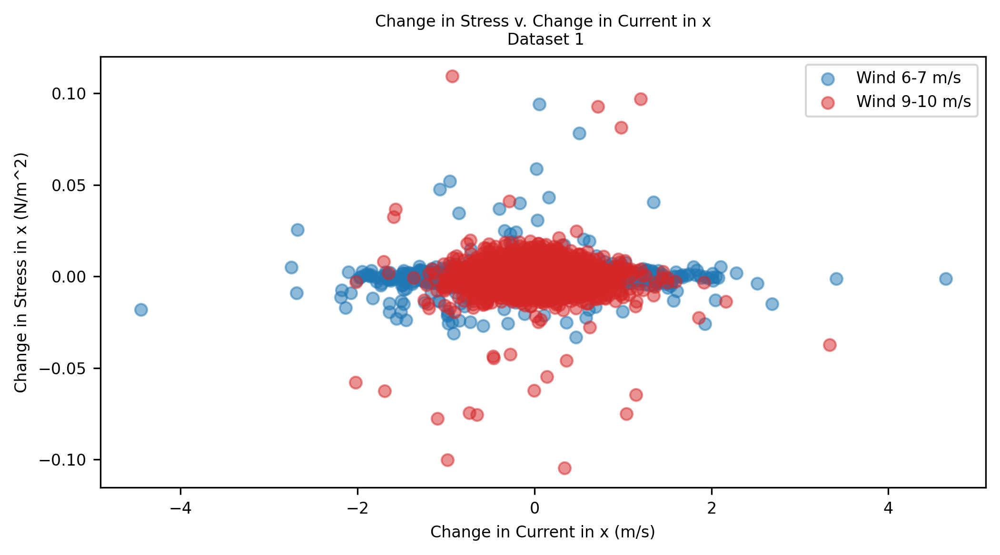

In [241]:
#stress x plot 1 

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid

plt.scatter(wind67_PerpX, wind67_Stress_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Stress_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")


plt.title('Change in Stress v. Change in Current in x\n Dataset 1')
plt.ylabel('Change in Stress in x (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


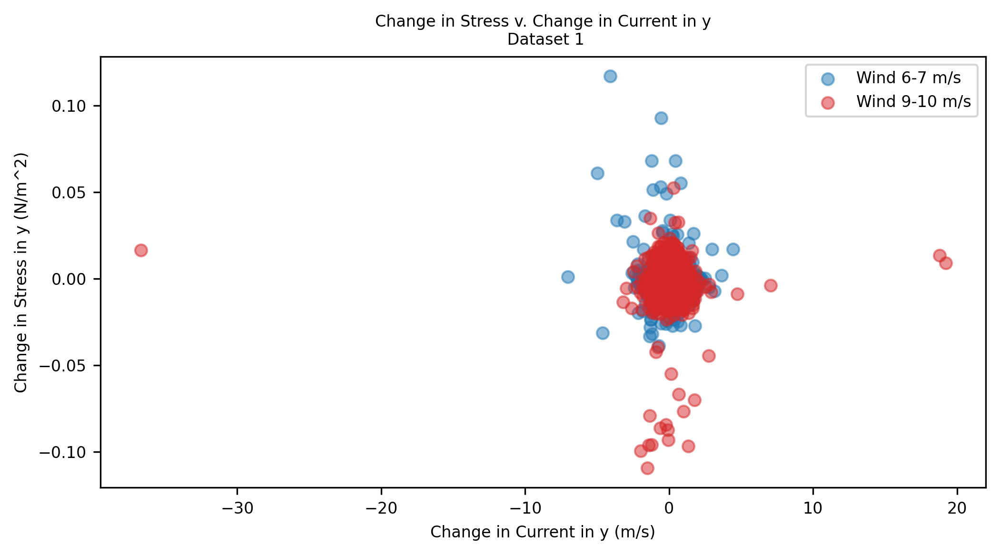

In [242]:
#stress y plot 1 

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid

plt.scatter(wind67_PerpY, wind67_Stress_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Stress_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")


plt.title('Change in Stress v. Change in Current in y\n Dataset 1')
plt.ylabel('Change in Stress in y (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()

In [244]:
#do wind bins for ds2 (6-10m/s) 
#bins 6-7, 7-8, 8-9, 9-10

numX=len(Lon2)
numY=len(Lat2)

#3rd dimension: diffy[0] diffx[1] - diff is xy
#this way to fill nans may cause div by 0 from nan*0

wind67stress=np.zeros((numY, numX, 2)) *np.nan
wind910stress=np.zeros((numY, numX, 2)) *np.nan

wind67stressCurl=np.zeros((numY, numX, 2))*np.nan
wind910stressCurl=np.zeros((numY, numX, 2))*np.nan
    
wind67currentMag=np.zeros((numY, numX, 2))*np.nan
wind910currentMag=np.zeros((numY, numX, 2))*np.nan

wind67perp=np.zeros((numY, numX, 2))*np.nan
wind910perp=np.zeros((numY, numX, 2))*np.nan

thresh=0.1

#-1 in loop to note I have nans on edges when I plot 
for y in range(0,len(Lat2-1)):
    for x in range(0,len(Lon2-1)):
        if np.isnan(windSpeed2[y,x]) == False:
            
            #calculate differences in x and y 
            currentMag_x=curMag2[y,x+1]-curMag2[y,x] 
            currentMag_y=curMag2[y+1,x]-curMag2[y,x] 
            
            stressMag_x=stressMag2[y,x+1]-stressMag2[y,x]
            stressMag_y=stressMag2[y+1,x]-stressMag2[y,x]

            stressCurlDiffx=stressCurl2[y,x+1]-stressCurl2[y,x]
            stressCurlDiffy=stressCurl2[y+1,x]-stressCurl2[y,x]
            
            #currentMag perp to wind
            #perpCurrent=U1_perp*uCur1 + V1_perp*vCur1
            perp_x=perpCurrent2[y,x+1]-perpCurrent2[y,x]
            perp_y=perpCurrent2[y+1,x]-perpCurrent2[y,x]
            
            #check current magnitude threshold 
            if currentMag_x <thresh:
                currentMag_x = np.nan
            if currentMag_y <thresh: 
                currentMag_y = np.nan
                

            elif windSpeed2[y,x] <7.0 and windSpeed2[y,x]>=6.0:

                wind67stressCurl[y,x,1]=stressCurlDiffx
                wind67stressCurl[y,x,0]=stressCurlDiffy
                
                wind67perp[y,x,1]=perp_x
                wind67perp[y,x,0]=perp_y
                      
                wind67stress[y,x,1]=stressMag_x
                wind67stress[y,x,0]=stressMag_y
                            
                wind67currentMag[y,x,1]=currentMag_x
                wind67currentMag[y,x,0]=currentMag_y

                
            elif windSpeed2[y,x]<10.0 and windSpeed2[y,x]>=9.0:
                
                wind910currentMag[y,x,1]=currentMag_x
                wind910currentMag[y,x,0]=currentMag_y
                
                wind910stressCurl[y,x,1]=stressCurlDiffx
                wind910stressCurl[y,x,0]=stressCurlDiffy
                      
                wind910stress[y,x,1]=stressMag_x
                wind910stress[y,x,0]=stressMag_y
                
                wind910perp[y,x,1]=perp_x
                wind910perp[y,x,0]=perp_y

                
            else: 
                continue 
                
                

In [245]:
#ds2
wind67_curMag_x=wind67currentMag[:,:,1].flatten()
wind910_curMag_x=wind910currentMag[:,:,1].flatten()

wind67_curMag_y=wind67currentMag[:,:,0].flatten()
wind910_curMag_y=wind910currentMag[:,:,0].flatten()

wind67_Curl_x=wind67stressCurl[:,:,1].flatten()
wind910_Curl_x=wind910stressCurl[:,:,1].flatten()

wind67_Curl_y=wind67stressCurl[:,:,0].flatten()
wind910_Curl_y=wind910stressCurl[:,:,0].flatten()

wind67_Stress_x=wind67stress[:,:,1].flatten()
wind910_Stress_x=wind910stress[:,:,1].flatten()

wind67_Stress_y=wind67stress[:,:,0].flatten()
wind910_Stress_y=wind910stress[:,:,0].flatten()

wind67_PerpX=wind67perp[:,:,1].flatten()
wind910_PerpX=wind910perp[:,:,1].flatten()

wind67_PerpY=wind67perp[:,:,0].flatten()
wind910_PerpY=wind910perp[:,:,0].flatten()



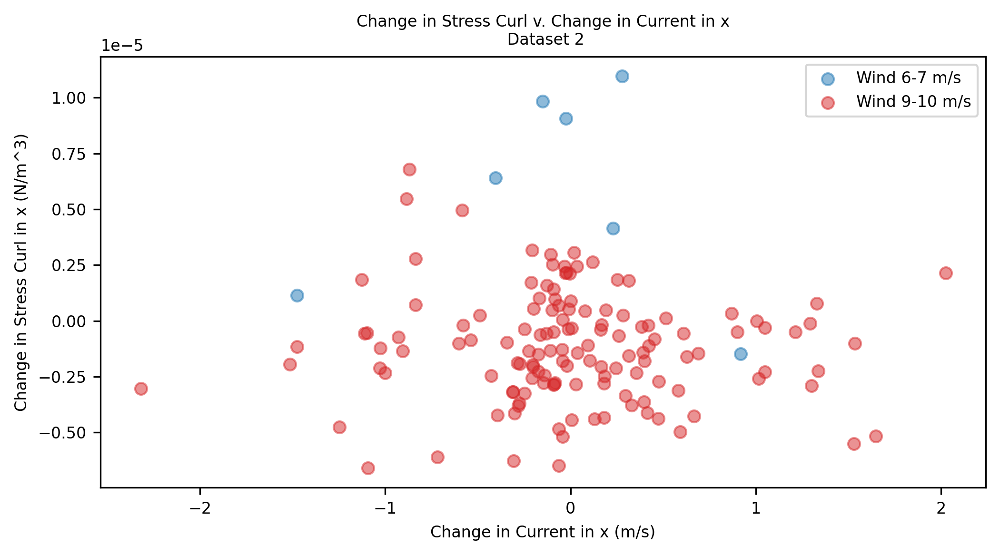

In [247]:
#stress curl x plot 2

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid
plt.scatter(wind67_PerpX, wind67_Curl_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Curl_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')


plt.legend(loc="upper right")

plt.title('Change in Stress Curl v. Change in Current in x\n Dataset 2')
plt.ylabel('Change in Stress Curl in x (N/m^3)')
plt.xlabel('Change in Current Perpenducular to the Wind in x (m/s)')

plt.show()


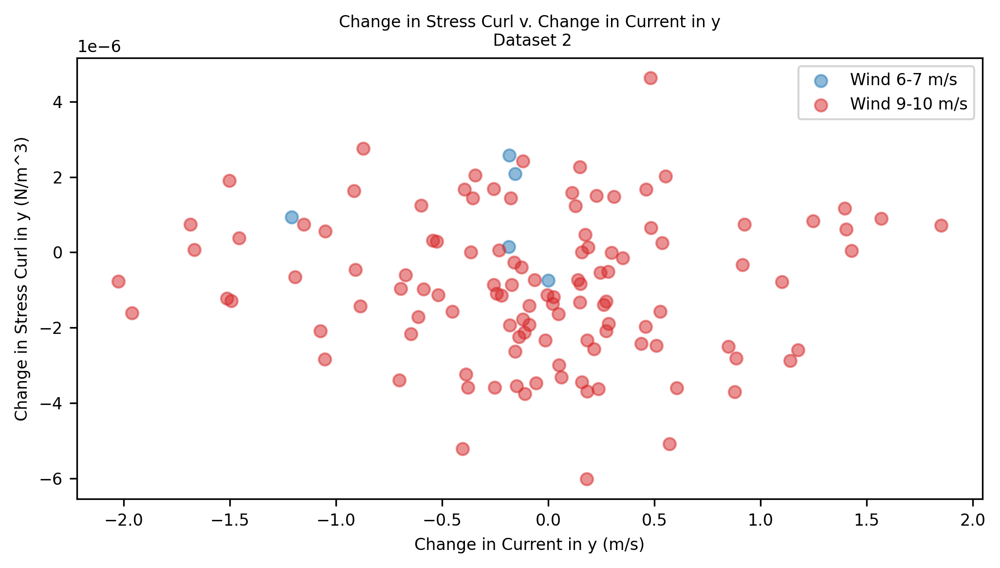

In [248]:
#stress curl y plot 2

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid

plt.scatter(wind67_PerpY, wind67_Curl_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Curl_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")

plt.title('Change in Stress Curl v. Change in Current in y\n Dataset 2')
plt.ylabel('Change in Stress Curl in y (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()

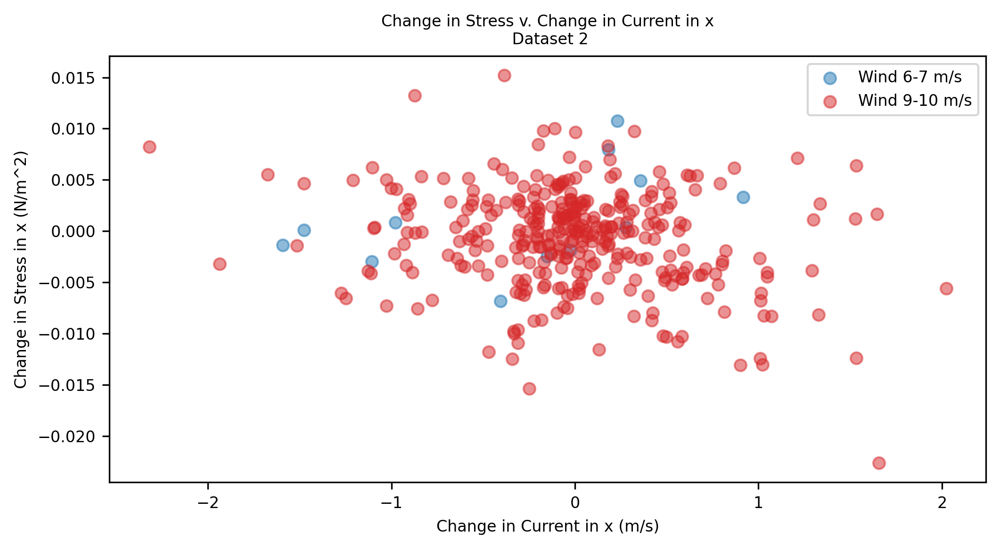

In [249]:
#stress x plot 2

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid
plt.scatter(wind67_PerpX, wind67_Stress_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Stress_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")

plt.title('Change in Stress v. Change in Current in x\n Dataset 2')
plt.ylabel('Change in Stress in x (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


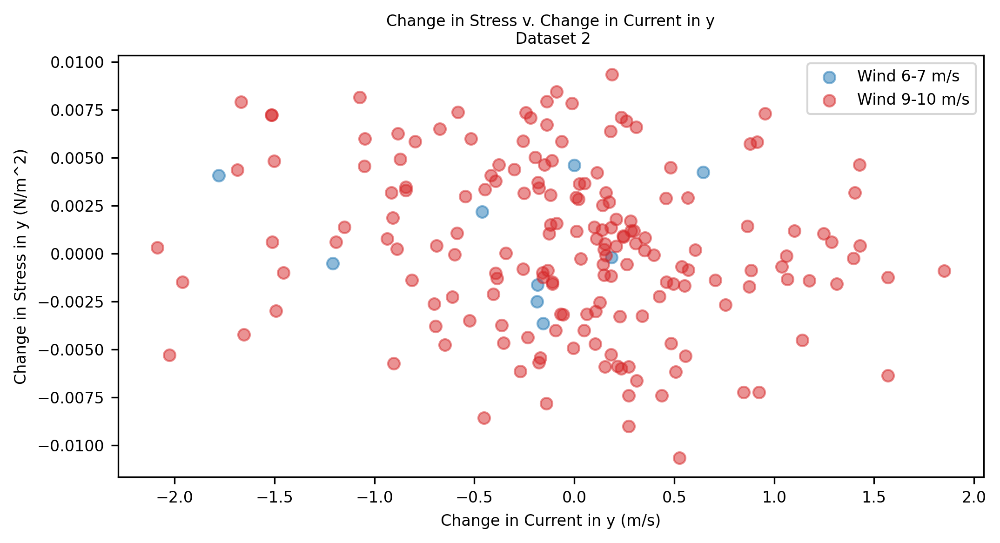

In [250]:
#stress y plot 2

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid
plt.scatter(wind67_PerpY, wind67_Stress_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Stress_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")

plt.title('Change in Stress v. Change in Current in y\n Dataset 2')
plt.ylabel('Change in Stress in y (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()

In [252]:
#ds3

numX=len(Lon3)
numY=len(Lat3)

#3rd dimension: diffy[0] diffx[1] - diff is xy
#this way to fill nans may cause div by 0 from nan*0

wind67stress=np.zeros((numY, numX, 2)) *np.nan
wind910stress=np.zeros((numY, numX, 2)) *np.nan

wind67stressCurl=np.zeros((numY, numX, 2))*np.nan
wind910stressCurl=np.zeros((numY, numX, 2))*np.nan
    
wind67currentMag=np.zeros((numY, numX, 2))*np.nan
wind910currentMag=np.zeros((numY, numX, 2))*np.nan

wind67perp=np.zeros((numY, numX, 2))*np.nan
wind910perp=np.zeros((numY, numX, 2))*np.nan

thresh=0.1

#-1 in loop to note I have nans on edges when I plot 
for y in range(0,len(Lat3-1)):
    for x in range(0,len(Lon3-1)):
        if np.isnan(windSpeed3[y,x]) == False:
            
            #calculate differences in x and y 
            currentMag_x=curMag3[y,x+1]-curMag3[y,x] 
            currentMag_y=curMag3[y+1,x]-curMag3[y,x] 
            
            stressMag_x=stressMag3[y,x+1]-stressMag3[y,x]
            stressMag_y=stressMag3[y+1,x]-stressMag3[y,x]

            stressCurlDiffx=stressCurl3[y,x+1]-stressCurl3[y,x]
            stressCurlDiffy=stressCurl3[y+1,x]-stressCurl3[y,x]
            
            #currentMag perp to wind
            #perpCurrent=U1_perp*uCur1 + V1_perp*vCur1
            perp_x=perpCurrent3[y,x+1]-perpCurrent3[y,x]
            perp_y=perpCurrent3[y+1,x]-perpCurrent3[y,x]
            
            #check current magnitude threshold 
            if currentMag_x <thresh:
                currentMag_x = np.nan
            if currentMag_y <thresh: 
                currentMag_y = np.nan
                

            elif windSpeed3[y,x] <7.0 and windSpeed3[y,x]>=6.0:

                wind67stressCurl[y,x,1]=stressCurlDiffx
                wind67stressCurl[y,x,0]=stressCurlDiffy
                
                wind67perp[y,x,1]=perp_x
                wind67perp[y,x,0]=perp_y
                      
                wind67stress[y,x,1]=stressMag_x
                wind67stress[y,x,0]=stressMag_y
                            
                wind67currentMag[y,x,1]=currentMag_x
                wind67currentMag[y,x,0]=currentMag_y

                
            elif windSpeed3[y,x]<10.0 and windSpeed3[y,x]>=9.0:
                
                wind910currentMag[y,x,1]=currentMag_x
                wind910currentMag[y,x,0]=currentMag_y
                
                wind910stressCurl[y,x,1]=stressCurlDiffx
                wind910stressCurl[y,x,0]=stressCurlDiffy
                      
                wind910stress[y,x,1]=stressMag_x
                wind910stress[y,x,0]=stressMag_y
                
                wind910perp[y,x,1]=perp_x
                wind910perp[y,x,0]=perp_y

                
            else: 
                continue 
                

In [253]:
wind67_curMag_x=wind67currentMag[:,:,1].flatten()
wind910_curMag_x=wind910currentMag[:,:,1].flatten()

wind67_curMag_y=wind67currentMag[:,:,0].flatten()
wind910_curMag_y=wind910currentMag[:,:,0].flatten()

wind67_Curl_x=wind67stressCurl[:,:,1].flatten()
wind910_Curl_x=wind910stressCurl[:,:,1].flatten()

wind67_Curl_y=wind67stressCurl[:,:,0].flatten()
wind910_Curl_y=wind910stressCurl[:,:,0].flatten()

wind67_Stress_x=wind67stress[:,:,1].flatten()
wind910_Stress_x=wind910stress[:,:,1].flatten()

wind67_Stress_y=wind67stress[:,:,0].flatten()
wind910_Stress_y=wind910stress[:,:,0].flatten()

wind67_PerpX=wind67perp[:,:,1].flatten()
wind910_PerpX=wind910perp[:,:,1].flatten()

wind67_PerpY=wind67perp[:,:,0].flatten()
wind910_PerpY=wind910perp[:,:,0].flatten()

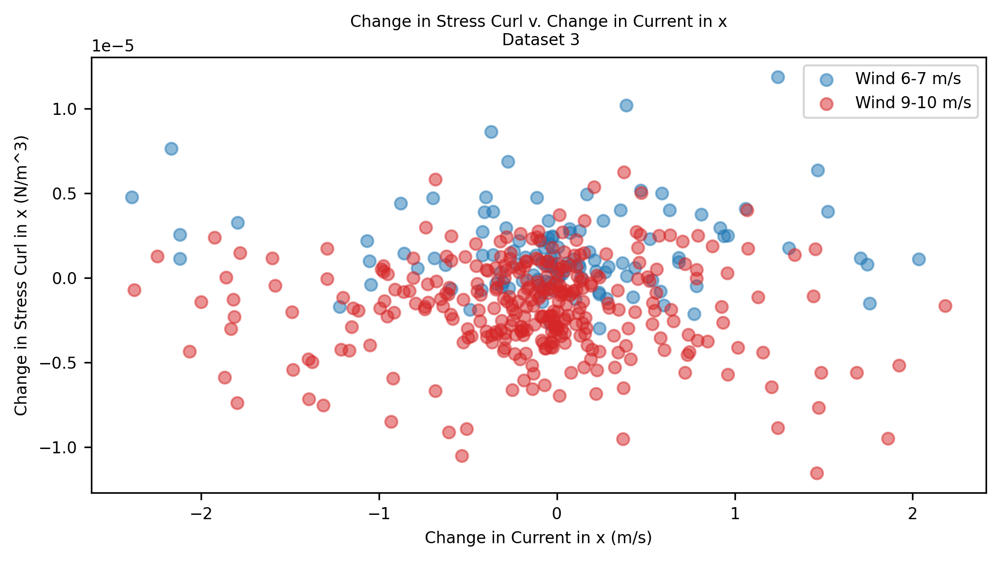

In [254]:
#stress curl x plot 3

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid
plt.scatter(wind67_PerpX, wind67_Curl_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Curl_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")

plt.title('Change in Stress Curl v. Change in Current in x\n Dataset 3')
plt.ylabel('Change in Stress Curl in x (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


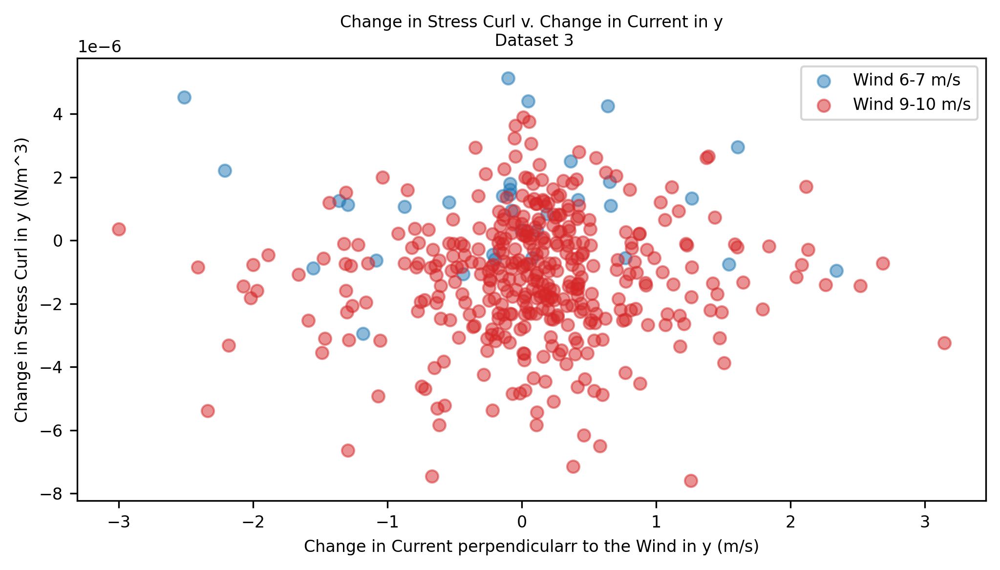

In [266]:
#stress curl y plot 3

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid
plt.scatter(wind67_PerpY, wind67_Curl_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Curl_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")

plt.title('Change in Stress Curl v. Change in Current in y\n Dataset 3')
plt.ylabel('Change in Stress Curl in y (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()

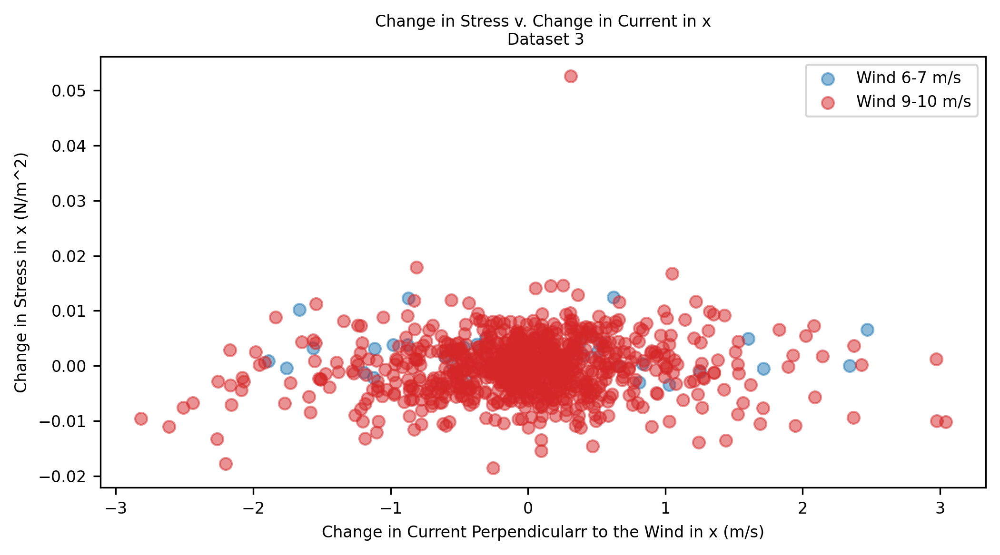

In [268]:
#stress x plot 3

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid
plt.scatter(wind67_PerpX, wind67_Stress_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Stress_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")

plt.title('Change in Stress v. Change in Current in x\n Dataset 3')
plt.ylabel('Change in Stress in x (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()

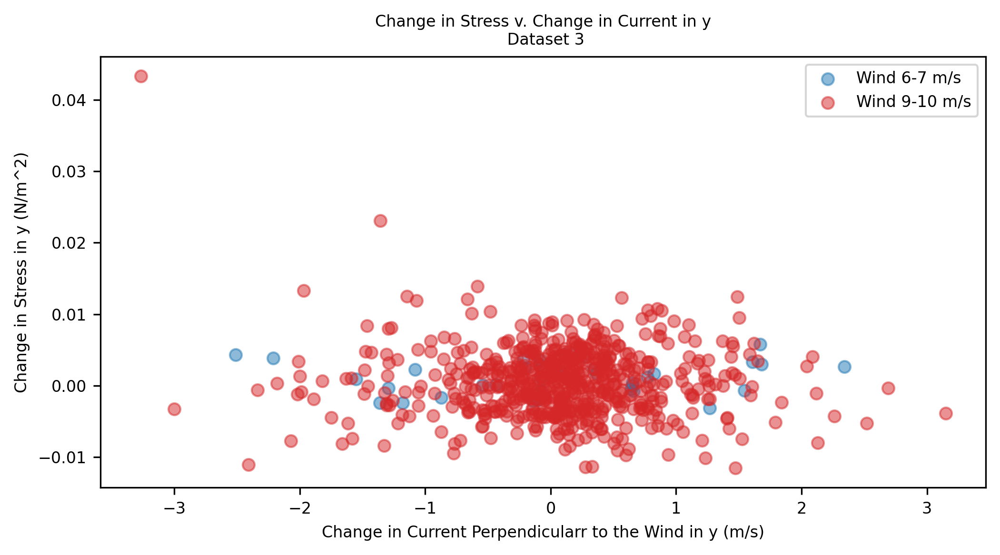

In [269]:
#stress y plot 3

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid
plt.scatter(wind67_PerpY, wind67_Stress_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Stress_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in y\n Dataset 3')
plt.ylabel('Change in Stress in y (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()

In [270]:
#ds4

numX=len(Lon4)
numY=len(Lat4)

#3rd dimension: diffy[0] diffx[1] - diff is xy
#this way to fill nans may cause div by 0 from nan*0

wind67stress=np.zeros((numY, numX, 2)) *np.nan
wind910stress=np.zeros((numY, numX, 2)) *np.nan

wind67stressCurl=np.zeros((numY, numX, 2))*np.nan
wind910stressCurl=np.zeros((numY, numX, 2))*np.nan
    
wind67currentMag=np.zeros((numY, numX, 2))*np.nan
wind910currentMag=np.zeros((numY, numX, 2))*np.nan

wind67perp=np.zeros((numY, numX, 2))*np.nan
wind910perp=np.zeros((numY, numX, 2))*np.nan

thresh=0.1

#-1 in loop to note I have nans on edges when I plot 
for y in range(0,len(Lat4-1)):
    for x in range(0,len(Lon4-1)):
        if np.isnan(windSpeed4[y,x]) == False:
            
            #calculate differences in x and y 
            currentMag_x=curMag4[y,x+1]-curMag4[y,x] 
            currentMag_y=curMag4[y+1,x]-curMag4[y,x] 
            
            stressMag_x=stressMag4[y,x+1]-stressMag4[y,x]
            stressMag_y=stressMag4[y+1,x]-stressMag4[y,x]

            stressCurlDiffx=stressCurl4[y,x+1]-stressCurl4[y,x]
            stressCurlDiffy=stressCurl4[y+1,x]-stressCurl4[y,x]
            
            #currentMag perp to wind
            #perpCurrent=U1_perp*uCur1 + V1_perp*vCur1
            perp_x=perpCurrent4[y,x+1]-perpCurrent4[y,x]
            perp_y=perpCurrent4[y+1,x]-perpCurrent4[y,x]
            
            #check current magnitude threshold 
            if currentMag_x <thresh:
                currentMag_x = np.nan
            if currentMag_y <thresh: 
                currentMag_y = np.nan
                

            elif windSpeed4[y,x] <7.0 and windSpeed4[y,x]>=6.0:

                wind67stressCurl[y,x,1]=stressCurlDiffx
                wind67stressCurl[y,x,0]=stressCurlDiffy
                
                wind67perp[y,x,1]=perp_x
                wind67perp[y,x,0]=perp_y
                      
                wind67stress[y,x,1]=stressMag_x
                wind67stress[y,x,0]=stressMag_y
                            
                wind67currentMag[y,x,1]=currentMag_x
                wind67currentMag[y,x,0]=currentMag_y

                
            elif windSpeed4[y,x]<10.0 and windSpeed4[y,x]>=9.0:
                
                wind910currentMag[y,x,1]=currentMag_x
                wind910currentMag[y,x,0]=currentMag_y
                
                wind910stressCurl[y,x,1]=stressCurlDiffx
                wind910stressCurl[y,x,0]=stressCurlDiffy
                      
                wind910stress[y,x,1]=stressMag_x
                wind910stress[y,x,0]=stressMag_y
                
                wind910perp[y,x,1]=perp_x
                wind910perp[y,x,0]=perp_y

                
            else: 
                continue 
                

In [271]:
#ds4 
wind67_curMag_x=wind67currentMag[:,:,1].flatten()
wind910_curMag_x=wind910currentMag[:,:,1].flatten()

wind67_curMag_y=wind67currentMag[:,:,0].flatten()
wind910_curMag_y=wind910currentMag[:,:,0].flatten()

wind67_Curl_x=wind67stressCurl[:,:,1].flatten()
wind910_Curl_x=wind910stressCurl[:,:,1].flatten()

wind67_Curl_y=wind67stressCurl[:,:,0].flatten()
wind910_Curl_y=wind910stressCurl[:,:,0].flatten()

wind67_Stress_x=wind67stress[:,:,1].flatten()
wind910_Stress_x=wind910stress[:,:,1].flatten()

wind67_Stress_y=wind67stress[:,:,0].flatten()
wind910_Stress_y=wind910stress[:,:,0].flatten()

wind67_PerpX=wind67perp[:,:,1].flatten()
wind910_PerpX=wind910perp[:,:,1].flatten()

wind67_PerpY=wind67perp[:,:,0].flatten()
wind910_PerpY=wind910perp[:,:,0].flatten()


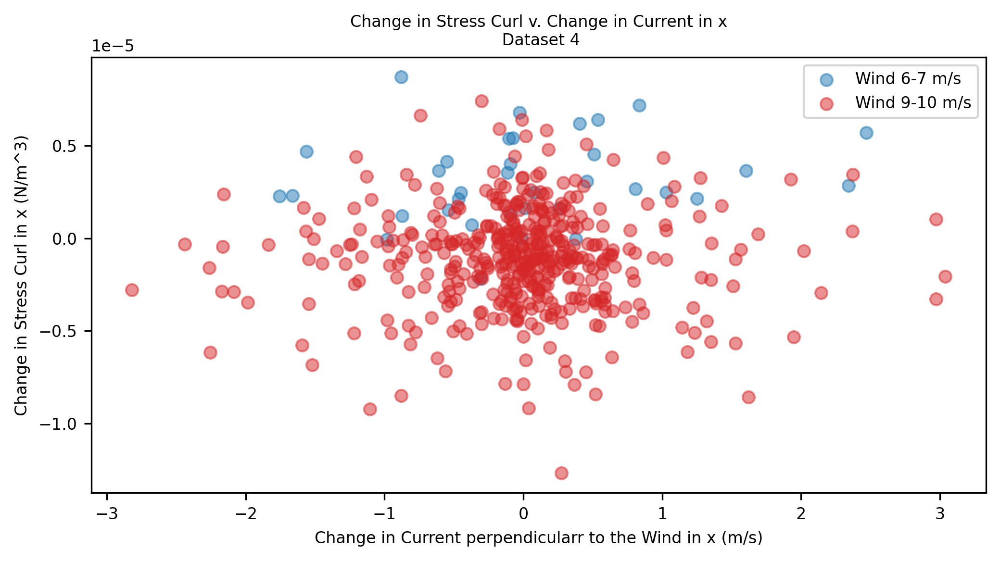

In [272]:
#stress curl x plot 4

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid

plt.scatter(wind67_PerpX, wind67_Curl_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Curl_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")

plt.title('Change in Stress Curl v. Change in Current in x\n Dataset 4')
plt.ylabel('Change in Stress Curl in x (N/m^3)')
plt.xlabel('Change in Current perpendicularr to the Wind in x (m/s)')

plt.show()



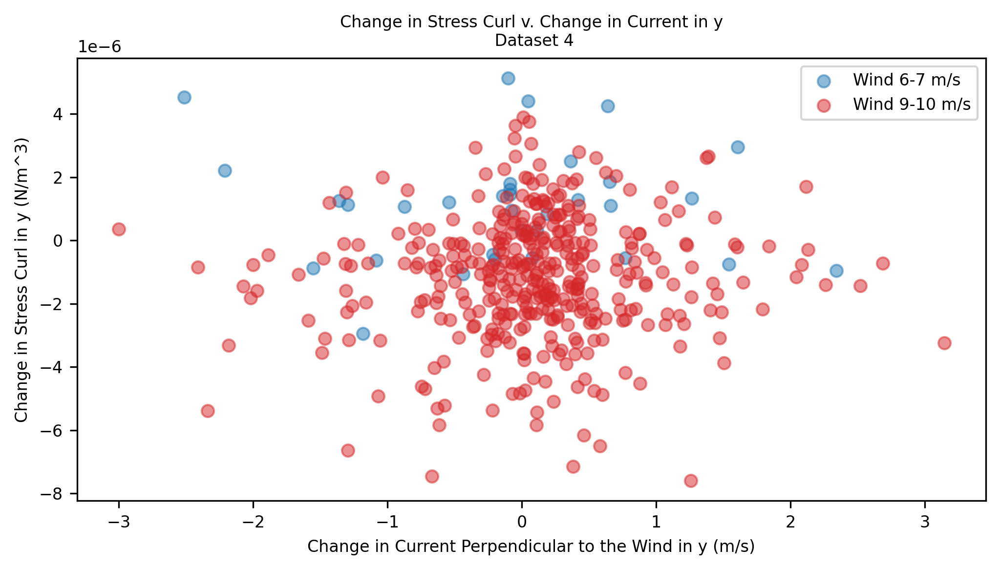

In [273]:
#stress curl y plot 4
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)


plt.scatter(wind67_PerpY, wind67_Curl_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Curl_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")
plt.title('Change in Stress Curl v. Change in Current in y\n Dataset 4')
plt.ylabel('Change in Stress Curl in y (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()



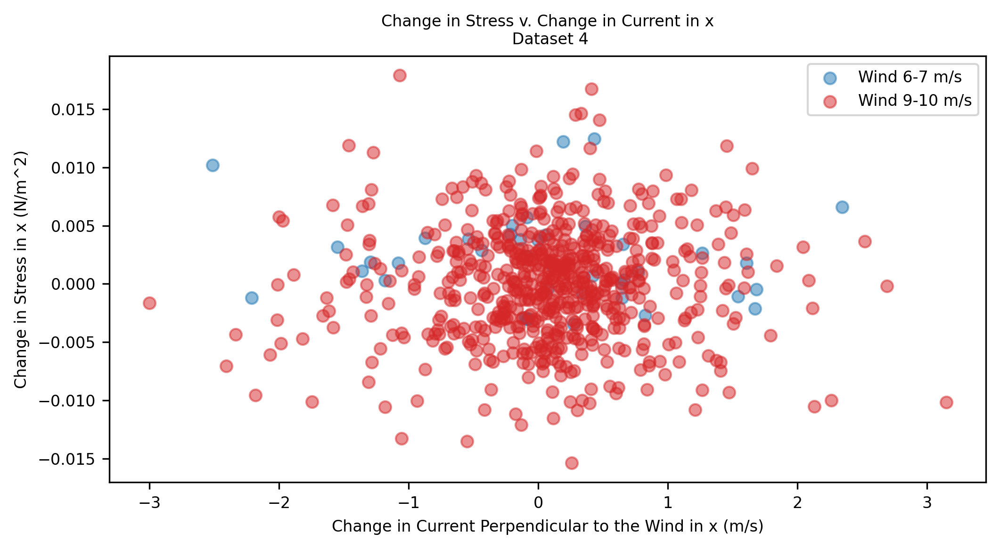

In [274]:
#stress x plot 4
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Stress_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Stress_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in x\n Dataset 4')
plt.ylabel('Change in Stress in x (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


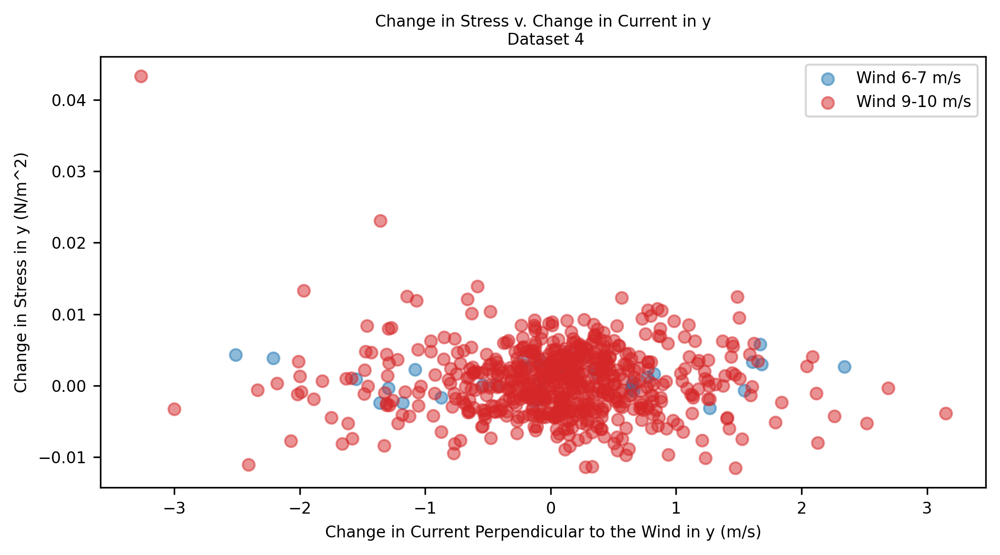

In [275]:
#stress y plot 4

figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Stress_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Stress_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')


plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in y\n Dataset 4')
plt.ylabel('Change in Stress in y (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()


In [276]:
#ds 5 
numX=len(Lon5)
numY=len(Lat5)

#3rd dimension: diffy[0] diffx[1] - diff is xy
#this way to fill nans may cause div by 0 from nan*0

wind67stress=np.zeros((numY, numX, 2)) *np.nan
wind910stress=np.zeros((numY, numX, 2)) *np.nan

wind67stressCurl=np.zeros((numY, numX, 2))*np.nan
wind910stressCurl=np.zeros((numY, numX, 2))*np.nan
    
wind67currentMag=np.zeros((numY, numX, 2))*np.nan
wind910currentMag=np.zeros((numY, numX, 2))*np.nan

wind67perp=np.zeros((numY, numX, 2))*np.nan
wind910perp=np.zeros((numY, numX, 2))*np.nan

thresh=0.1

#-1 in loop to note I have nans on edges when I plot 
for y in range(0,len(Lat5-1)):
    for x in range(0,len(Lon5-1)):
        if np.isnan(windSpeed5[y,x]) == False:
            
            #calculate differences in x and y 
            currentMag_x=curMag5[y,x+1]-curMag5[y,x] 
            currentMag_y=curMag5[y+1,x]-curMag5[y,x] 
            
            stressMag_x=stressMag5[y,x+1]-stressMag5[y,x]
            stressMag_y=stressMag5[y+1,x]-stressMag5[y,x]

            stressCurlDiffx=stressCurl5[y,x+1]-stressCurl5[y,x]
            stressCurlDiffy=stressCurl5[y+1,x]-stressCurl5[y,x]
            
            #currentMag perp to wind
            #perpCurrent=U1_perp*uCur1 + V1_perp*vCur1
            perp_x=perpCurrent5[y,x+1]-perpCurrent5[y,x]
            perp_y=perpCurrent5[y+1,x]-perpCurrent5[y,x]
            
            #check current magnitude threshold 
            if currentMag_x <thresh:
                currentMag_x = np.nan
            if currentMag_y <thresh: 
                currentMag_y = np.nan
                

            elif windSpeed5[y,x] <7.0 and windSpeed5[y,x]>=6.0:

                wind67stressCurl[y,x,1]=stressCurlDiffx
                wind67stressCurl[y,x,0]=stressCurlDiffy
                
                wind67perp[y,x,1]=perp_x
                wind67perp[y,x,0]=perp_y
                      
                wind67stress[y,x,1]=stressMag_x
                wind67stress[y,x,0]=stressMag_y
                            
                wind67currentMag[y,x,1]=currentMag_x
                wind67currentMag[y,x,0]=currentMag_y

                
            elif windSpeed5[y,x]<10.0 and windSpeed5[y,x]>=9.0:
                
                wind910currentMag[y,x,1]=currentMag_x
                wind910currentMag[y,x,0]=currentMag_y
                
                wind910stressCurl[y,x,1]=stressCurlDiffx
                wind910stressCurl[y,x,0]=stressCurlDiffy
                      
                wind910stress[y,x,1]=stressMag_x
                wind910stress[y,x,0]=stressMag_y
                
                wind910perp[y,x,1]=perp_x
                wind910perp[y,x,0]=perp_y

                
            else: 
                continue 

In [277]:
#ds5
wind67_curMag_x=wind67currentMag[:,:,1].flatten()
wind910_curMag_x=wind910currentMag[:,:,1].flatten()

wind67_curMag_y=wind67currentMag[:,:,0].flatten()
wind910_curMag_y=wind910currentMag[:,:,0].flatten()

wind67_Curl_x=wind67stressCurl[:,:,1].flatten()
wind910_Curl_x=wind910stressCurl[:,:,1].flatten()

wind67_Curl_y=wind67stressCurl[:,:,0].flatten()
wind910_Curl_y=wind910stressCurl[:,:,0].flatten()

wind67_Stress_x=wind67stress[:,:,1].flatten()
wind910_Stress_x=wind910stress[:,:,1].flatten()

wind67_Stress_y=wind67stress[:,:,0].flatten()
wind910_Stress_y=wind910stress[:,:,0].flatten()

wind67_PerpX=wind67perp[:,:,1].flatten()
wind910_PerpX=wind910perp[:,:,1].flatten()

wind67_PerpY=wind67perp[:,:,0].flatten()
wind910_PerpY=wind910perp[:,:,0].flatten()



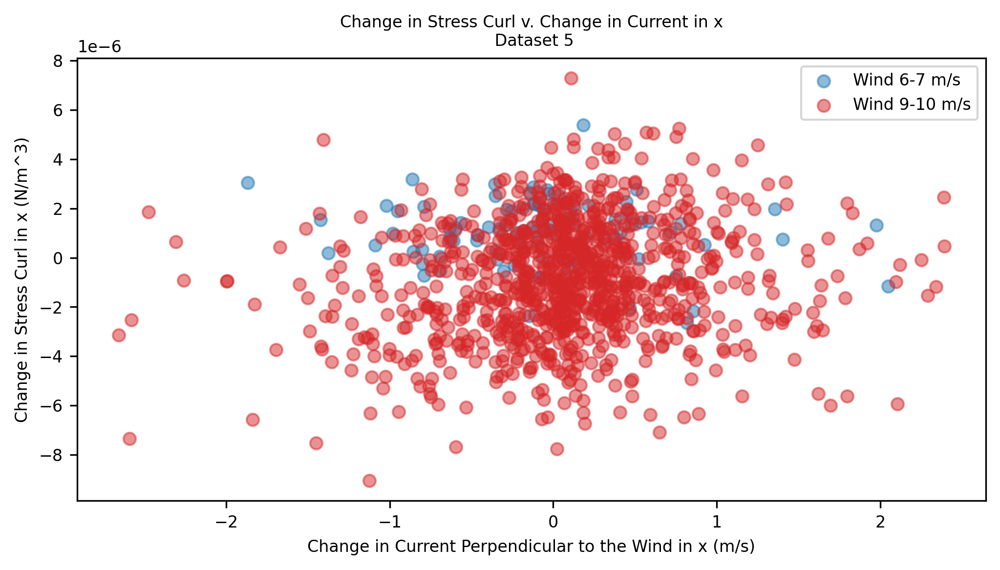

In [279]:
#stress curl x plot 5

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid

plt.scatter(wind67_PerpX, wind67_Curl_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Curl_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")

plt.title('Change in Stress Curl v. Change in Current in x\n Dataset 5')
plt.ylabel('Change in Stress Curl in x (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


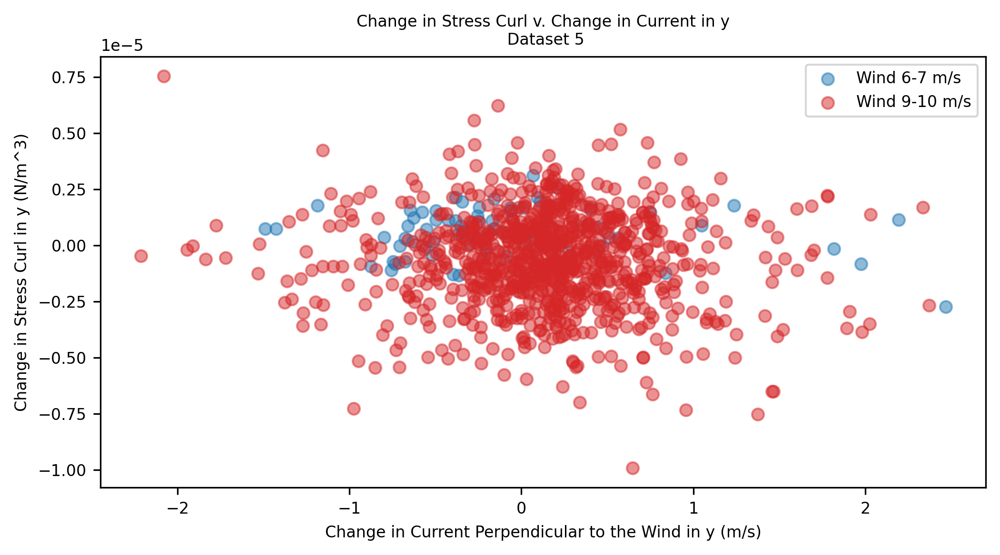

In [280]:
#stress curl y plot 5
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Curl_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Curl_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress Curl v. Change in Current in y\n Dataset 5')
plt.ylabel('Change in Stress Curl in y (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()

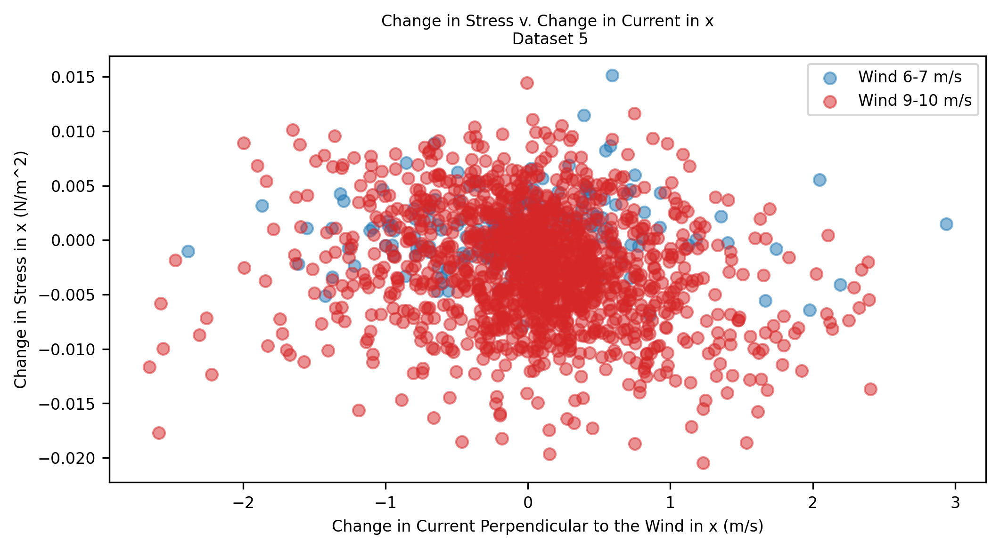

In [281]:
#stress x plot 5
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpX, wind67_Stress_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Stress_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in x\n Dataset 5')
plt.ylabel('Change in Stress in x (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


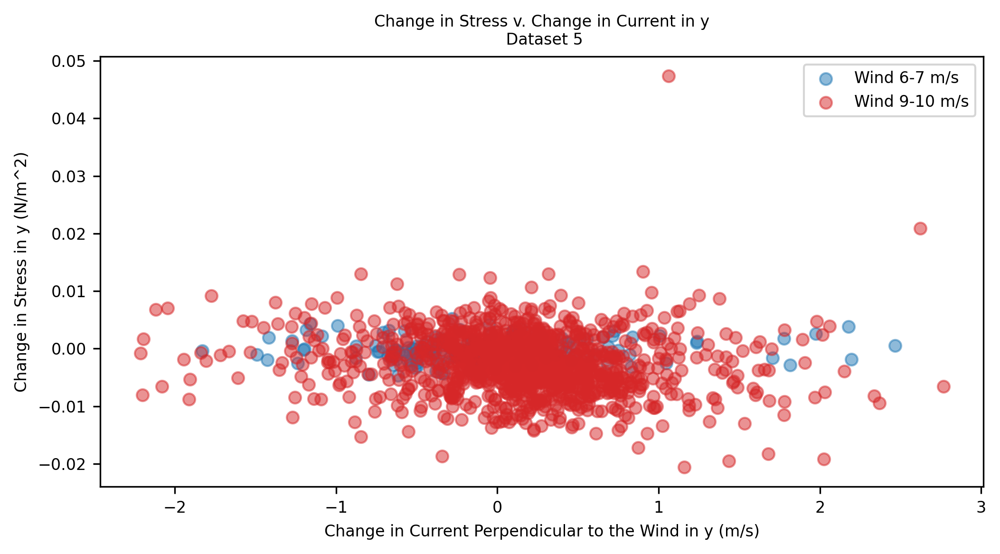

In [282]:
#stress y plot 5

figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Stress_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Stress_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')


plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in y\n Dataset 5')
plt.ylabel('Change in Stress in y (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()


In [283]:
#ds7

numX=len(Lon7)
numY=len(Lat7)

#3rd dimension: diffy[0] diffx[1] - diff is xy
#this way to fill nans may cause div by 0 from nan*0

wind67stress=np.zeros((numY, numX, 2)) *np.nan
wind910stress=np.zeros((numY, numX, 2)) *np.nan

wind67stressCurl=np.zeros((numY, numX, 2))*np.nan
wind910stressCurl=np.zeros((numY, numX, 2))*np.nan
    
wind67currentMag=np.zeros((numY, numX, 2))*np.nan
wind910currentMag=np.zeros((numY, numX, 2))*np.nan

wind67perp=np.zeros((numY, numX, 2))*np.nan
wind910perp=np.zeros((numY, numX, 2))*np.nan

thresh=0.1

#-1 in loop to note I have nans on edges when I plot 
for y in range(0,len(Lat7-1)):
    for x in range(0,len(Lon7-1)):
        if np.isnan(windSpeed7[y,x]) == False:
            
            #calculate differences in x and y 
            currentMag_x=curMag7[y,x+1]-curMag7[y,x] 
            currentMag_y=curMag7[y+1,x]-curMag7[y,x] 
            
            stressMag_x=stressMag7[y,x+1]-stressMag7[y,x]
            stressMag_y=stressMag7[y+1,x]-stressMag7[y,x]

            stressCurlDiffx=stressCurl7[y,x+1]-stressCurl7[y,x]
            stressCurlDiffy=stressCurl7[y+1,x]-stressCurl7[y,x]
            
            #currentMag perp to wind
            #perpCurrent=U1_perp*uCur1 + V1_perp*vCur1
            perp_x=perpCurrent7[y,x+1]-perpCurrent7[y,x]
            perp_y=perpCurrent7[y+1,x]-perpCurrent7[y,x]
            
            #check current magnitude threshold 
            if currentMag_x <thresh:
                currentMag_x = np.nan
            if currentMag_y <thresh: 
                currentMag_y = np.nan
                

            elif windSpeed7[y,x] <7.0 and windSpeed7[y,x]>=6.0:

                wind67stressCurl[y,x,1]=stressCurlDiffx
                wind67stressCurl[y,x,0]=stressCurlDiffy
                
                wind67perp[y,x,1]=perp_x
                wind67perp[y,x,0]=perp_y
                      
                wind67stress[y,x,1]=stressMag_x
                wind67stress[y,x,0]=stressMag_y
                            
                wind67currentMag[y,x,1]=currentMag_x
                wind67currentMag[y,x,0]=currentMag_y

                
            elif windSpeed7[y,x]<10.0 and windSpeed7[y,x]>=9.0:
                
                wind910currentMag[y,x,1]=currentMag_x
                wind910currentMag[y,x,0]=currentMag_y
                
                wind910stressCurl[y,x,1]=stressCurlDiffx
                wind910stressCurl[y,x,0]=stressCurlDiffy
                      
                wind910stress[y,x,1]=stressMag_x
                wind910stress[y,x,0]=stressMag_y
                
                wind910perp[y,x,1]=perp_x
                wind910perp[y,x,0]=perp_y

                
            else: 
                continue 



In [169]:
#ds7
wind67_curMag_x=wind67currentMag[:,:,1].flatten()
wind910_curMag_x=wind910currentMag[:,:,1].flatten()

wind67_curMag_y=wind67currentMag[:,:,0].flatten()
wind910_curMag_y=wind910currentMag[:,:,0].flatten()

wind67_Curl_x=wind67stressCurl[:,:,1].flatten()
wind910_Curl_x=wind910stressCurl[:,:,1].flatten()

wind67_Curl_y=wind67stressCurl[:,:,0].flatten()
wind910_Curl_y=wind910stressCurl[:,:,0].flatten()

wind67_Stress_x=wind67stress[:,:,1].flatten()
wind910_Stress_x=wind910stress[:,:,1].flatten()

wind67_Stress_y=wind67stress[:,:,0].flatten()
wind910_Stress_y=wind910stress[:,:,0].flatten()

wind67_PerpX=wind67perp[:,:,1].flatten()
wind910_PerpX=wind910perp[:,:,1].flatten()

wind67_PerpY=wind67perp[:,:,0].flatten()
wind910_PerpY=wind910perp[:,:,0].flatten()



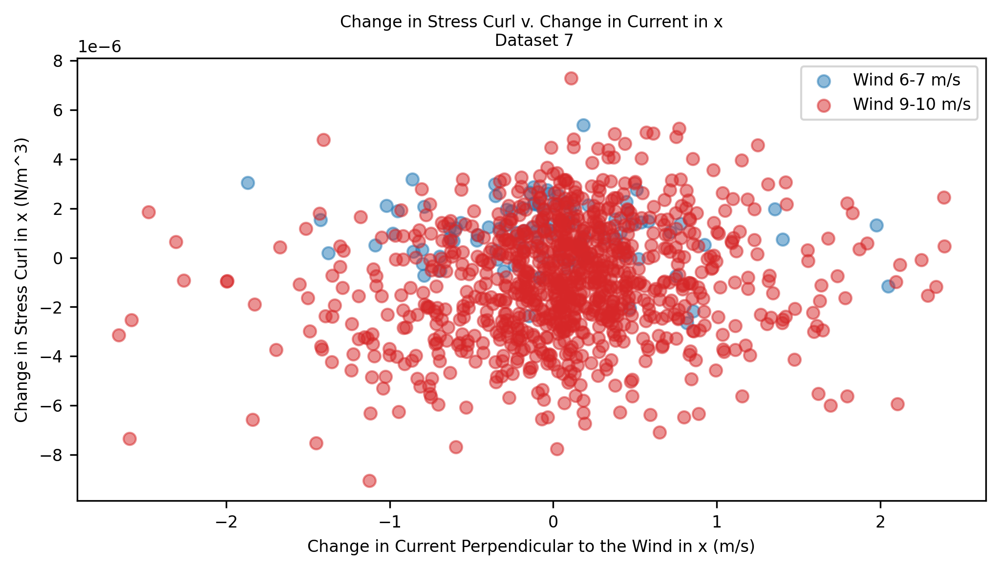

In [285]:

#stress curl x plot 7

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

plt.scatter(wind67_PerpX, wind67_Curl_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Curl_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")

plt.title('Change in Stress Curl v. Change in Current in x\n Dataset 7')
plt.ylabel('Change in Stress Curl in x (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


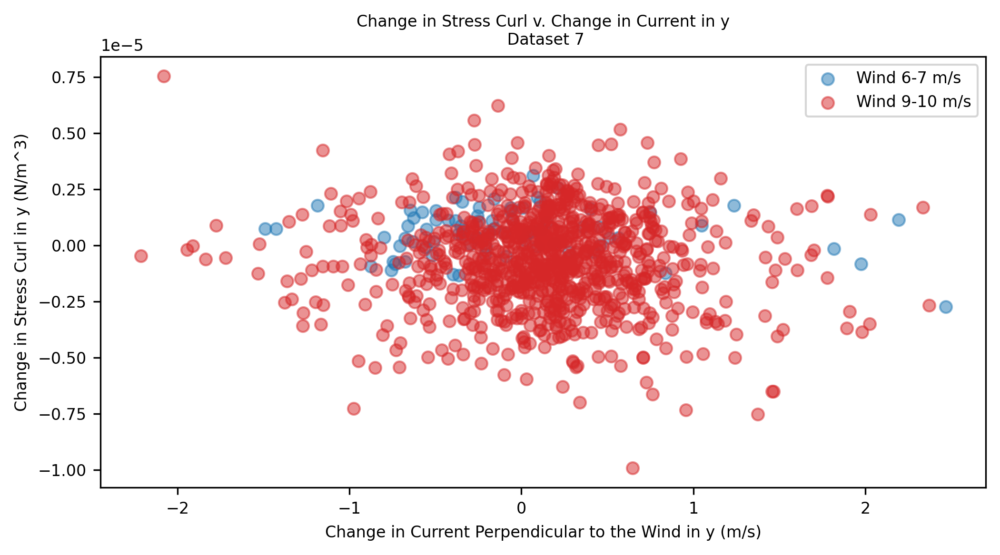

In [286]:
#stress curl y plot 7
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Curl_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Curl_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress Curl v. Change in Current in y\n Dataset 7')
plt.ylabel('Change in Stress Curl in y (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()


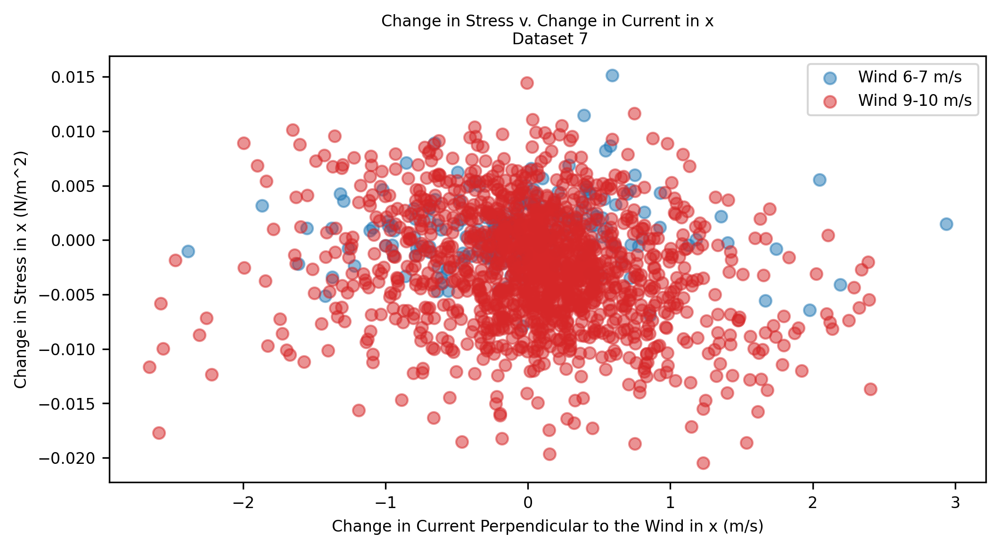

In [287]:
#stress x plot 7
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpX, wind67_Stress_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Stress_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in x\n Dataset 7')
plt.ylabel('Change in Stress in x (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


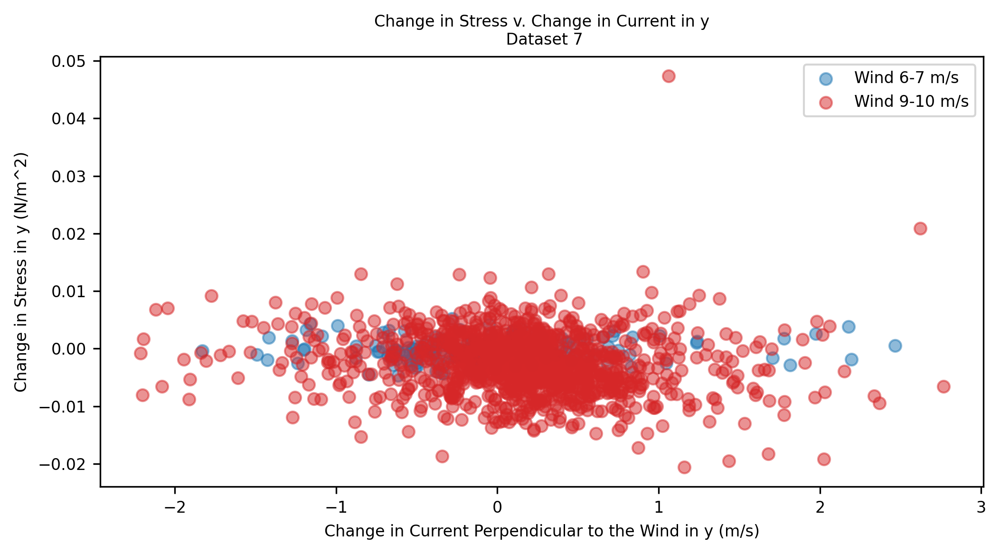

In [288]:
#stress y plot 7

figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Stress_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Stress_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in y\n Dataset 7')
plt.ylabel('Change in Stress in y (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()


In [289]:
#ds8

numX=len(Lon8)
numY=len(Lat8)

#3rd dimension: diffy[0] diffx[1] - diff is xy
#this way to fill nans may cause div by 0 from nan*0

wind67stress=np.zeros((numY, numX, 2)) *np.nan
wind910stress=np.zeros((numY, numX, 2)) *np.nan

wind67stressCurl=np.zeros((numY, numX, 2))*np.nan
wind910stressCurl=np.zeros((numY, numX, 2))*np.nan
    
wind67currentMag=np.zeros((numY, numX, 2))*np.nan
wind910currentMag=np.zeros((numY, numX, 2))*np.nan

wind67perp=np.zeros((numY, numX, 2))*np.nan
wind910perp=np.zeros((numY, numX, 2))*np.nan

thresh=0.1

#-1 in loop to note I have nans on edges when I plot 
for y in range(0,len(Lat8-1)):
    for x in range(0,len(Lon8-1)):
        if np.isnan(windSpeed8[y,x]) == False:
            
            #calculate differences in x and y 
            currentMag_x=curMag8[y,x+1]-curMag8[y,x] 
            currentMag_y=curMag8[y+1,x]-curMag8[y,x] 
            
            stressMag_x=stressMag8[y,x+1]-stressMag8[y,x]
            stressMag_y=stressMag8[y+1,x]-stressMag8[y,x]

            stressCurlDiffx=stressCurl8[y,x+1]-stressCurl8[y,x]
            stressCurlDiffy=stressCurl8[y+1,x]-stressCurl8[y,x]
            
            #currentMag perp to wind
            #perpCurrent=U1_perp*uCur1 + V1_perp*vCur1
            perp_x=perpCurrent8[y,x+1]-perpCurrent8[y,x]
            perp_y=perpCurrent8[y+1,x]-perpCurrent8[y,x]
            
            #check current magnitude threshold 
            if currentMag_x <thresh:
                currentMag_x = np.nan
            if currentMag_y <thresh: 
                currentMag_y = np.nan
                

            elif windSpeed8[y,x] <7.0 and windSpeed8[y,x]>=6.0:

                wind67stressCurl[y,x,1]=stressCurlDiffx
                wind67stressCurl[y,x,0]=stressCurlDiffy
                
                wind67perp[y,x,1]=perp_x
                wind67perp[y,x,0]=perp_y
                      
                wind67stress[y,x,1]=stressMag_x
                wind67stress[y,x,0]=stressMag_y
                            
                wind67currentMag[y,x,1]=currentMag_x
                wind67currentMag[y,x,0]=currentMag_y

                
            elif windSpeed8[y,x]<10.0 and windSpeed8[y,x]>=9.0:
                
                wind910currentMag[y,x,1]=currentMag_x
                wind910currentMag[y,x,0]=currentMag_y
                
                wind910stressCurl[y,x,1]=stressCurlDiffx
                wind910stressCurl[y,x,0]=stressCurlDiffy
                      
                wind910stress[y,x,1]=stressMag_x
                wind910stress[y,x,0]=stressMag_y
                
                wind910perp[y,x,1]=perp_x
                wind910perp[y,x,0]=perp_y

                
            else: 
                continue 

In [290]:
#ds8
wind67_curMag_x=wind67currentMag[:,:,1].flatten()
wind910_curMag_x=wind910currentMag[:,:,1].flatten()

wind67_curMag_y=wind67currentMag[:,:,0].flatten()
wind910_curMag_y=wind910currentMag[:,:,0].flatten()

wind67_Curl_x=wind67stressCurl[:,:,1].flatten()
wind910_Curl_x=wind910stressCurl[:,:,1].flatten()

wind67_Curl_y=wind67stressCurl[:,:,0].flatten()
wind910_Curl_y=wind910stressCurl[:,:,0].flatten()

wind67_Stress_x=wind67stress[:,:,1].flatten()
wind910_Stress_x=wind910stress[:,:,1].flatten()

wind67_Stress_y=wind67stress[:,:,0].flatten()
wind910_Stress_y=wind910stress[:,:,0].flatten()

wind67_PerpX=wind67perp[:,:,1].flatten()
wind910_PerpX=wind910perp[:,:,1].flatten()

wind67_PerpY=wind67perp[:,:,0].flatten()
wind910_PerpY=wind910perp[:,:,0].flatten()


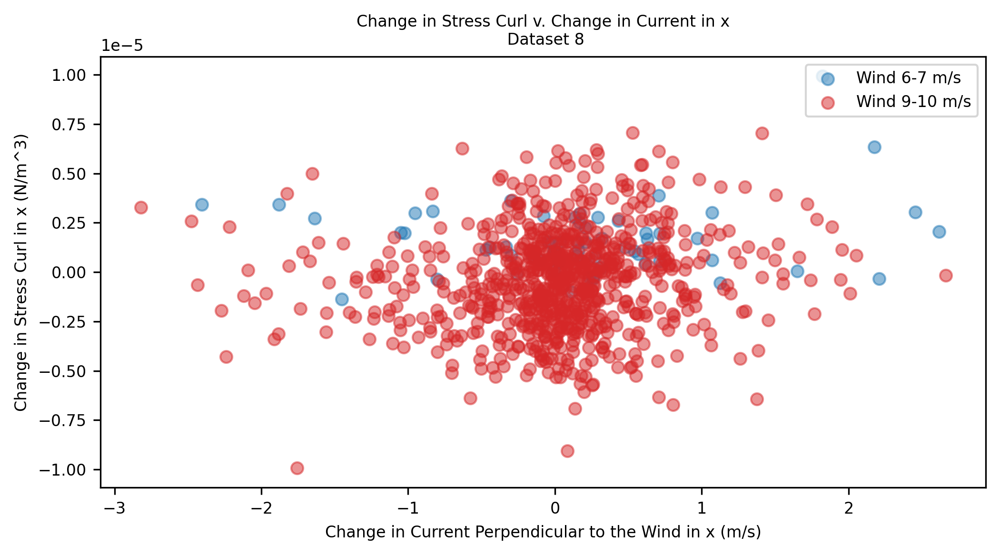

In [293]:

#stress curl x plot 8

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid
plt.scatter(wind67_PerpX, wind67_Curl_x ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Curl_x ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")

plt.title('Change in Stress Curl v. Change in Current in x\n Dataset 8')
plt.ylabel('Change in Stress Curl in x (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


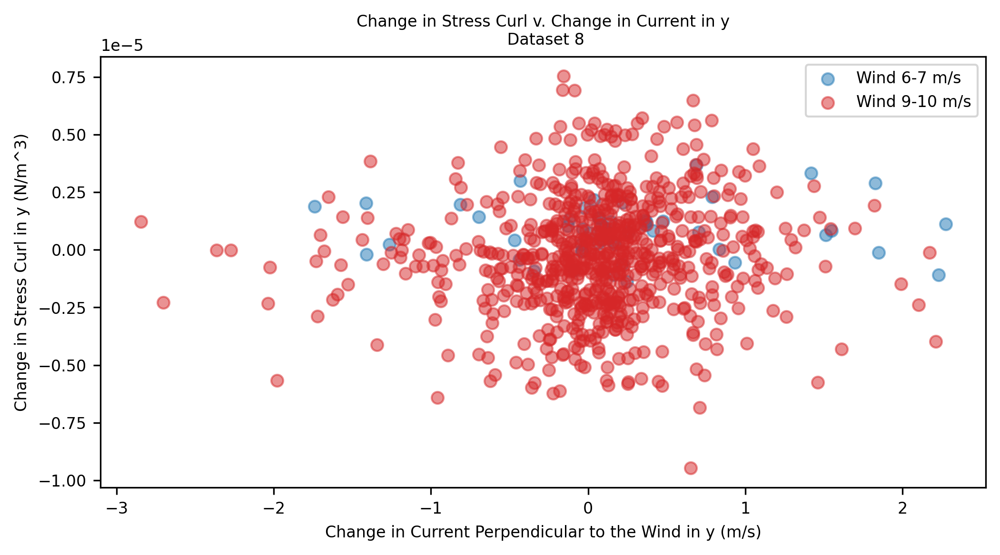

In [294]:
#stress curl y plot 8
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Curl_y ,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Curl_y ,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress Curl v. Change in Current in y\n Dataset 8')
plt.ylabel('Change in Stress Curl in y (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()


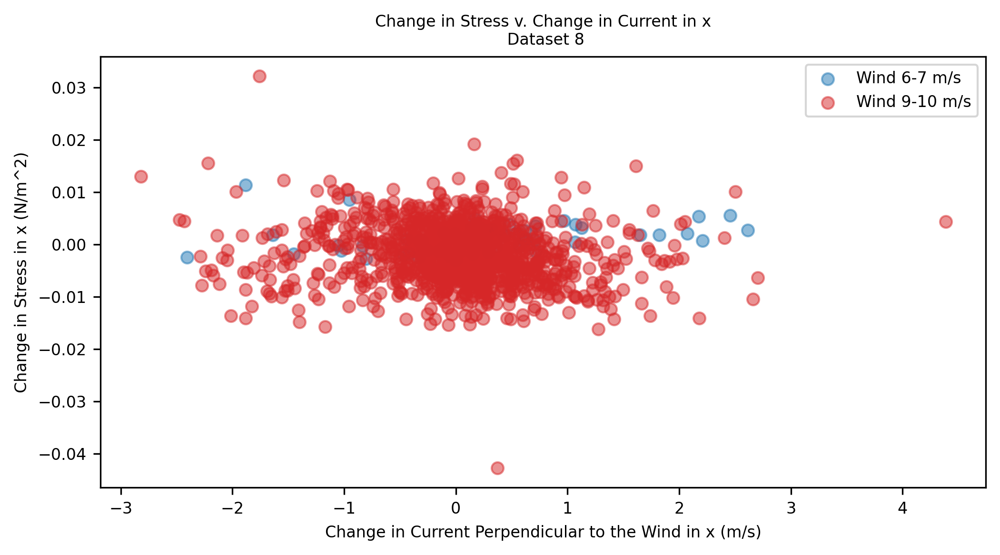

In [295]:
#stress x plot 8
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)


plt.scatter(wind67_PerpX, wind67_Stress_x,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Stress_x,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in x\n Dataset 8')
plt.ylabel('Change in Stress in x (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()


Text(0.5, 0, 'Change in Current Perpendicular to the Wind in y (m/s)')

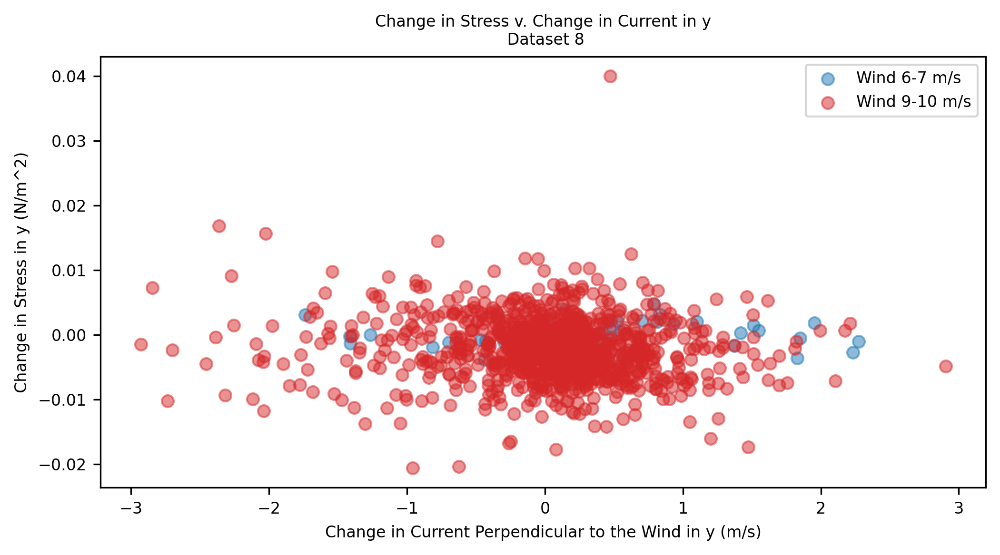

In [297]:
#stress y plot 8

figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Stress_y,color='tab:blue', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Stress_y,color='tab:red', alpha=0.50, label='Wind 9-10 m/s')


plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in y\n Dataset 8')
plt.ylabel('Change in Stress in y (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')



In [304]:
#ds 10

numX=len(Lon10)
numY=len(Lat10)

#3rd dimension: diffy[0] diffx[1] - diff is xy
#this way to fill nans may cause div by 0 from nan*0
wind67stress=np.zeros((numY, numX, 2)) *np.nan
wind910stress=np.zeros((numY, numX, 2)) *np.nan

wind67stressCurl=np.zeros((numY, numX, 2))*np.nan
wind910stressCurl=np.zeros((numY, numX, 2))*np.nan
    
wind67currentMag=np.zeros((numY, numX, 2))*np.nan
wind910currentMag=np.zeros((numY, numX, 2))*np.nan

wind67perp=np.zeros((numY, numX, 2))*np.nan
wind910perp=np.zeros((numY, numX, 2))*np.nan

thresh=0.1

#-1 in loop to note I have nans on edges when I plot 
for y in range(0,len(Lat10-1)):
    for x in range(0,len(Lon10-1)):
        if np.isnan(windSpeed10[y,x]) == False:
            
            #calculate differences in x and y 
            currentMag_x=curMag10[y,x+1]-curMag10[y,x] 
            currentMag_y=curMag10[y+1,x]-curMag10[y,x] 
            
            stressMag_x=stressMag10[y,x+1]-stressMag10[y,x]
            stressMag_y=stressMag10[y+1,x]-stressMag10[y,x]

            stressCurlDiffx=stressCurl10[y,x+1]-stressCurl10[y,x]
            stressCurlDiffy=stressCurl10[y+1,x]-stressCurl10[y,x]
            
            #currentMag perp to wind
            #perpCurrent=U1_perp*uCur1 + V1_perp*vCur1
            perp_x=perpCurrent10[y,x+1]-perpCurrent10[y,x]
            perp_y=perpCurrent10[y+1,x]-perpCurrent10[y,x]
            
            #check current magnitude threshold 
            if currentMag_x <thresh:
                currentMag_x = np.nan
            if currentMag_y <thresh: 
                currentMag_y = np.nan
                

            elif windSpeed10[y,x] <7.0 and windSpeed10[y,x]>=6.0:

                wind67stressCurl[y,x,1]=stressCurlDiffx
                wind67stressCurl[y,x,0]=stressCurlDiffy
                
                wind67perp[y,x,1]=perp_x
                wind67perp[y,x,0]=perp_y
                      
                wind67stress[y,x,1]=stressMag_x
                wind67stress[y,x,0]=stressMag_y
                            
                wind67currentMag[y,x,1]=currentMag_x
                wind67currentMag[y,x,0]=currentMag_y

                
            elif windSpeed10[y,x]<10.0 and windSpeed10[y,x]>=9.0:
                
                wind910currentMag[y,x,1]=currentMag_x
                wind910currentMag[y,x,0]=currentMag_y
                
                wind910stressCurl[y,x,1]=stressCurlDiffx
                wind910stressCurl[y,x,0]=stressCurlDiffy
                      
                wind910stress[y,x,1]=stressMag_x
                wind910stress[y,x,0]=stressMag_y
                
                wind910perp[y,x,1]=perp_x
                wind910perp[y,x,0]=perp_y

                
            else: 
                continue 

In [305]:
wind67_curMag_x=wind67currentMag[:,:,1].flatten()
wind910_curMag_x=wind910currentMag[:,:,1].flatten()

wind67_curMag_y=wind67currentMag[:,:,0].flatten()
wind910_curMag_y=wind910currentMag[:,:,0].flatten()

wind67_Curl_x=wind67stressCurl[:,:,1].flatten()
wind910_Curl_x=wind910stressCurl[:,:,1].flatten()

wind67_Curl_y=wind67stressCurl[:,:,0].flatten()
wind910_Curl_y=wind910stressCurl[:,:,0].flatten()

wind67_Stress_x=wind67stress[:,:,1].flatten()
wind910_Stress_x=wind910stress[:,:,1].flatten()

wind67_Stress_y=wind67stress[:,:,0].flatten()
wind910_Stress_y=wind910stress[:,:,0].flatten()

wind67_PerpX=wind67perp[:,:,1].flatten()
wind910_PerpX=wind910perp[:,:,1].flatten()

wind67_PerpY=wind67perp[:,:,0].flatten()
wind910_PerpY=wind910perp[:,:,0].flatten()



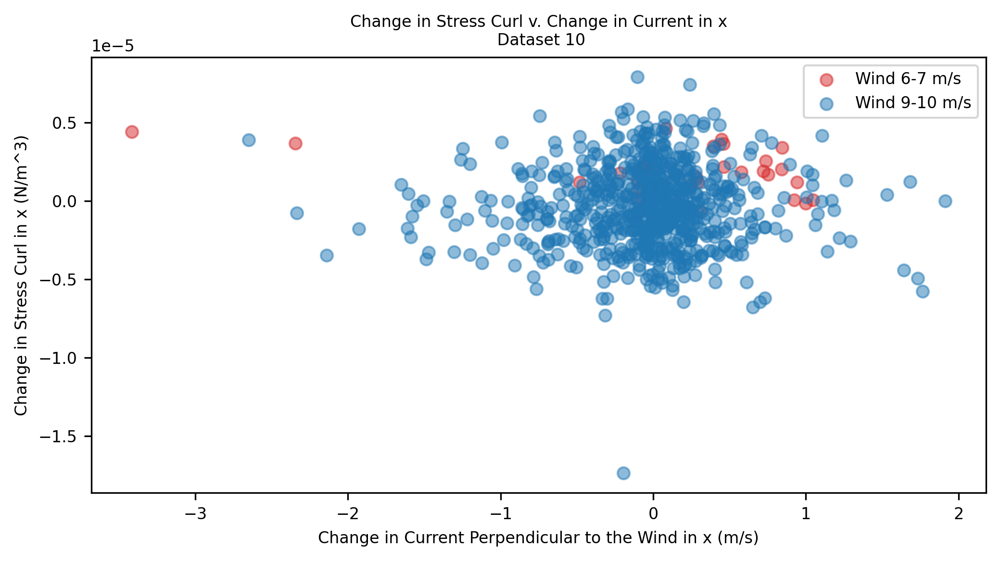

In [307]:
#stress curl x plot 10

SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

figure(figsize=(8,4), dpi=300)

#alpha between 0 and 1, 0=transparent, 1=solid

plt.scatter(wind67_PerpX, wind67_Curl_x ,color='tab:red', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Curl_x ,color='tab:blue', alpha=0.50, label='Wind 9-10 m/s')
plt.legend(loc="upper right")


plt.title('Change in Stress Curl v. Change in Current in x\n Dataset 10')
plt.ylabel('Change in Stress Curl in x (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()

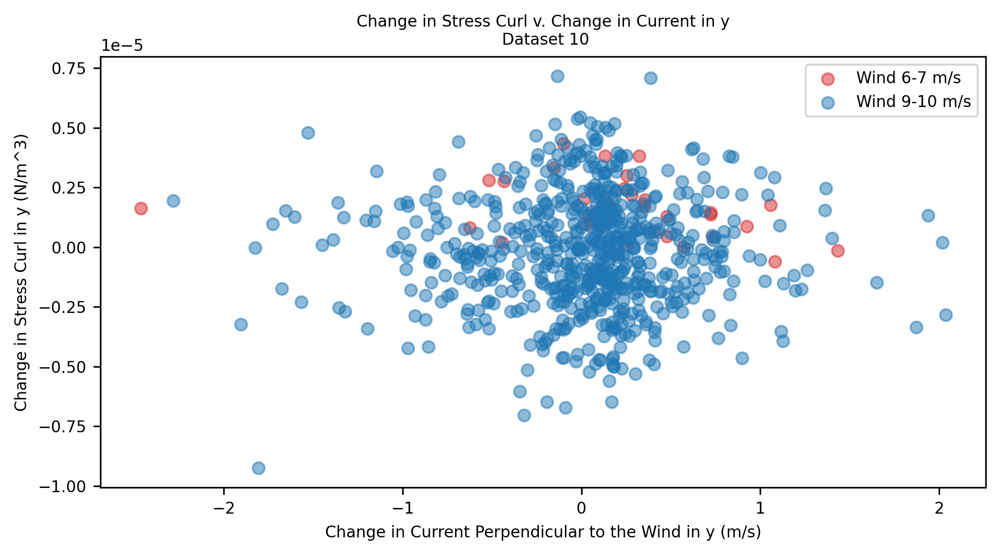

In [308]:
#stress curl y plot 10
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Curl_y ,color='tab:red', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Curl_y ,color='tab:blue', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress Curl v. Change in Current in y\n Dataset 10')
plt.ylabel('Change in Stress Curl in y (N/m^3)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()

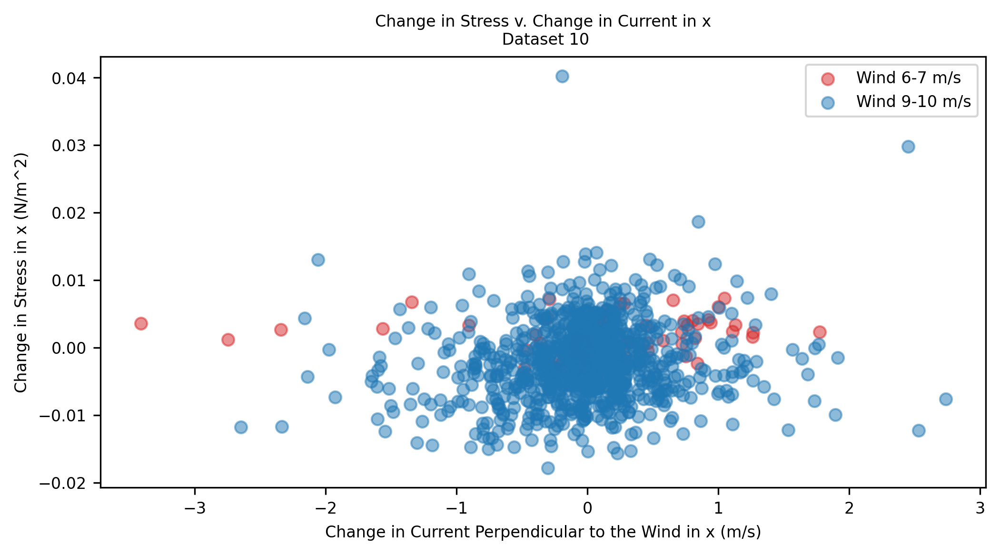

In [309]:
#stress x plot 10
figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpX, wind67_Stress_x ,color='tab:red', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpX, wind910_Stress_x ,color='tab:blue', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in x\n Dataset 10')
plt.ylabel('Change in Stress in x (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in x (m/s)')

plt.show()

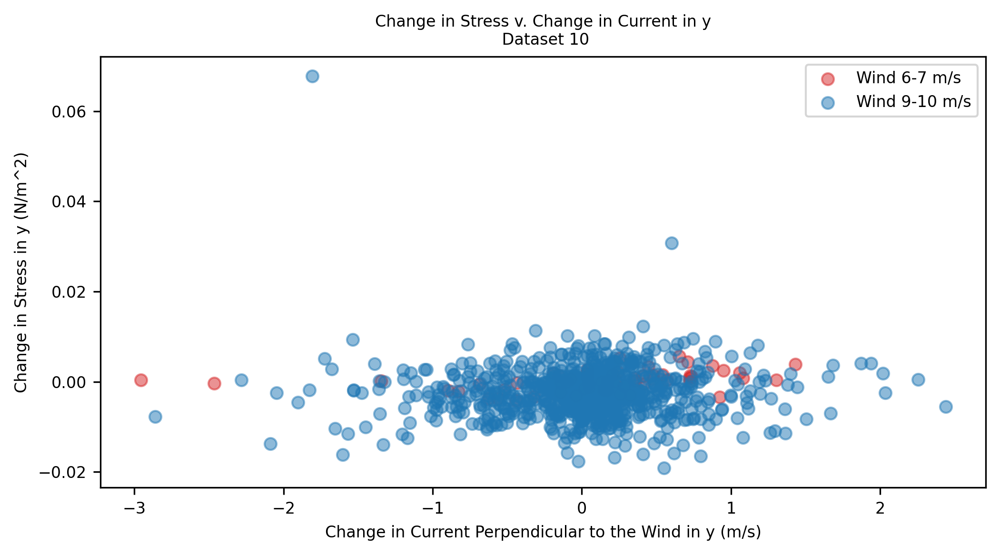

In [310]:
#stress y plot 10

figure(figsize=(8,4), dpi=300)
SMALL_SIZE = 8
plt.rc('font', size=SMALL_SIZE)
plt.rc('axes', titlesize=SMALL_SIZE)

plt.scatter(wind67_PerpY, wind67_Stress_y ,color='tab:red', alpha=0.50, label='Wind 6-7 m/s')
plt.scatter(wind910_PerpY, wind910_Stress_y ,color='tab:blue', alpha=0.50, label='Wind 9-10 m/s')

plt.legend(loc="upper right")
plt.title('Change in Stress v. Change in Current in y\n Dataset 10')
plt.ylabel('Change in Stress in y (N/m^2)')
plt.xlabel('Change in Current Perpendicular to the Wind in y (m/s)')

plt.show()